In [1]:
import os
import copy
import time
from typing import Tuple

import cv2
import numpy as np
from numpy import linalg as LA
import matplotlib.pyplot as plt
import pandas as pd
# import plotly.express as px # optional, used for visualization
import seaborn as sns
# from sklearn.preprocessing import MinMaxScaler

plt.style.use('fivethirtyeight')
plt.rcParams['figure.figsize'] = (12, 12)
plt.rcParams['figure.dpi'] = 120
# sns.set_style('darkgrid')

# Task 1: Harris Corner Detector

In [52]:
# %load Task1/harris.py
"""
CLAB Task-1: Harris Corner Detector
Your name (Your uniID): u7233149
"""

def conv2(img, conv_filter):
    # flip the filter
    f_siz_1, f_size_2 = conv_filter.shape
    conv_filter = conv_filter[range(f_siz_1 - 1, -1, -1), :][:, range(f_siz_1 - 1, -1, -1)]
    pad = (conv_filter.shape[0] - 1) // 2
    result = np.zeros((img.shape))
    img = np.pad(img, pad_width=pad, mode='constant', constant_values=0)
    filter_size = conv_filter.shape[0]
    for r in np.arange(img.shape[0] - filter_size + 1):
        for c in np.arange(img.shape[1] - filter_size + 1):
            curr_region = img[r:r + filter_size, c:c + filter_size]
            curr_result = curr_region * conv_filter
            conv_sum = np.sum(curr_result)  # Summing the result of multiplication.
            result[r, c] = conv_sum  # Saving the summation in the convolution layer feature map.

    return result


def fspecial(shape=(3, 3), sigma=0.5):
    """
    Create gaussian filter based on specified parameter, shape and sigma.
    The 2DGaussian will be a function of distance from the center and the provided sigma.
    
    P ~ Norm(0, sigma)
    h[i, j] = P(d) where P(d) is the probability density function of the specified gaussian distribution, 
    and d is distance from center (0,0) to the posiution i, j.
    
    The closer d is to 0, the higher h[i, j] is.
    The output matrix (kernel) will be normalized to have sum of 1
    """
    m, n = [(ss - 1.) / 2. for ss in shape]
    y, x = np.ogrid[-m:m + 1, -n:n + 1]
    h = np.exp(-(x * x + y * y) / (2. * sigma * sigma))
    h[h < np.finfo(h.dtype).eps * h.max()] = 0
    sumh = h.sum()
    if sumh != 0: # shouldn't this be if sumh != 1?
        h /= sumh
    return h



# Parameters, add more if needed
sigma = 5
# thresh = 0.01
harris_kernel_shape = (5, 5)
k = 0.05

# Derivative masks
dx = np.array([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]])
dy = dx.transpose()

try:
    bw = plt.imread('0.png')
except:
    bw = plt.imread('Task1/Harris-1.jpg')
    bw = cv2.cvtColor(bw, cv2.COLOR_RGB2GRAY)

    
bw = np.array(bw * 255, dtype=int)

# computer x and y derivatives of image
Ix = conv2(bw, dx)
Iy = conv2(bw, dy)

# gaussian filter
g = fspecial(
    (
        max(1, np.floor(3 * sigma) * 2 + 1), 
        max(1, np.floor(3 * sigma) * 2 + 1)
    ), 
    sigma
)

Iy2 = conv2(np.power(Iy, 2), g)
Ix2 = conv2(np.power(Ix, 2), g)
Ixy = conv2(Ix * Iy, g)



######################################################################
# Task: Compute the Harris Cornerness
######################################################################

# if w(x, y) is (1, 1), don't need to apply convolution
if harris_kernel_shape == (1, 1):
    lambda_1 = Ix2
    lambda_2 = Iy2
# else, for each pixel position, we will add up Ix2 and Iy2 of each pixel that overlaps with the fitler
else:
    kernel = np.ones(harris_kernel_shape)
    lambda_1 = conv2(Ix2, kernel)
    lambda_2 = conv2(Iy2, kernel)

# calculate determinant and trace of matrix M for each pixel in the image, and finally compute R
det_m = lambda_1 * lambda_2 - np.square(conv2(Ixy, kernel))
trace_m = lambda_1 + lambda_2
R = det_m - (k * np.square(trace_m))

######################################################################
# Task: Perform non-maximum suppression and
#       thresholding, return the N corner points
#       as an Nx2 matrix of x and y coordinates
######################################################################

def non_maximum_suppression(R):
    """
    Perform non-maximum suppression by finding pixels that have intensity greater than 8 neighbors.
    
    input:
        R: 2-d numpy array of corner response values
    returns:
        corners: list of corner positions described by tuple (x, y)
        arr: 2-d numpy binary array where arr[i, j] == 1 indicates corner as detected by non-maximum suppression
    """
    
    corners = []
    for i in range(1, len(R)-1):
        for j in range(1, len(R[0])-1):
            # check if R[i,j] is a corner by comparing each pixel to 8 neighbors
            if (
                (R[i,j] >= R[i+1,j]) & (R[i,j] >= R[i-1,j]) & (R[i,j] >= R[i,j+1]) & (R[i,j] >= R[i,j-1]) & 
                (R[i,j] >= R[i+1,j+1]) & (R[i,j] >= R[i-1,j-1]) & (R[i,j] >= R[i-1,j+1]) & (R[i,j] >= R[i-1,j-1])
            ):
                corners += (i, j),

    # create a binary array from corners array to visualize corners
    arr = np.zeros(R.shape)
    for corner in corners:
        arr[corner[0], corner[1]] = 1
    return corners, arr

corners, Nx2 = non_maximum_suppression(R)

In [3]:
def get_R(img, sigma = 5, harris_kernel_shape = (5, 5), k = 0.05):
    """ for task 1.4
    
    Parameters are optimized for Harris-1.jpg
    """
    
    img = np.array(img * 255, dtype=int)

    # computer x and y derivatives of image
    Ix = conv2(img, dx)
    Iy = conv2(img, dy)

    # gaussian filter
    g = fspecial(
        (
            max(1, np.floor(3 * sigma) * 2 + 1), 
            max(1, np.floor(3 * sigma) * 2 + 1)
        ), 
        sigma
    )

    Iy2 = conv2(np.power(Iy, 2), g)
    Ix2 = conv2(np.power(Ix, 2), g)
    Ixy = conv2(Ix * Iy, g)

    ######################################################################
    # Task: Compute the Harris Cornerness
    ######################################################################

    # if w(x, y) is (1, 1), don't need to apply convolution
    if harris_kernel_shape == (1, 1):
        lambda_1 = Ix2
        lambda_2 = Iy2
        det_m = lambda_1 * lambda_2 - Ixy * Ixy
    # else, for each pixel position, we will add up Ix2 and Iy2 of each pixel that overlaps with the fitler
    else:
        kernel = np.ones(harris_kernel_shape)
        lambda_1 = conv2(Ix2, kernel)
        lambda_2 = conv2(Iy2, kernel)

        # calculate determinant and trace of matrix M for each pixel in the image, and finally compute R
        det_m = lambda_1 * lambda_2 - np.square(conv2(Ixy, kernel))
        
    trace_m = lambda_1 + lambda_2
    R = det_m - (k * np.square(trace_m))
    return R

## 1.4 Test function get_R() on sample images 

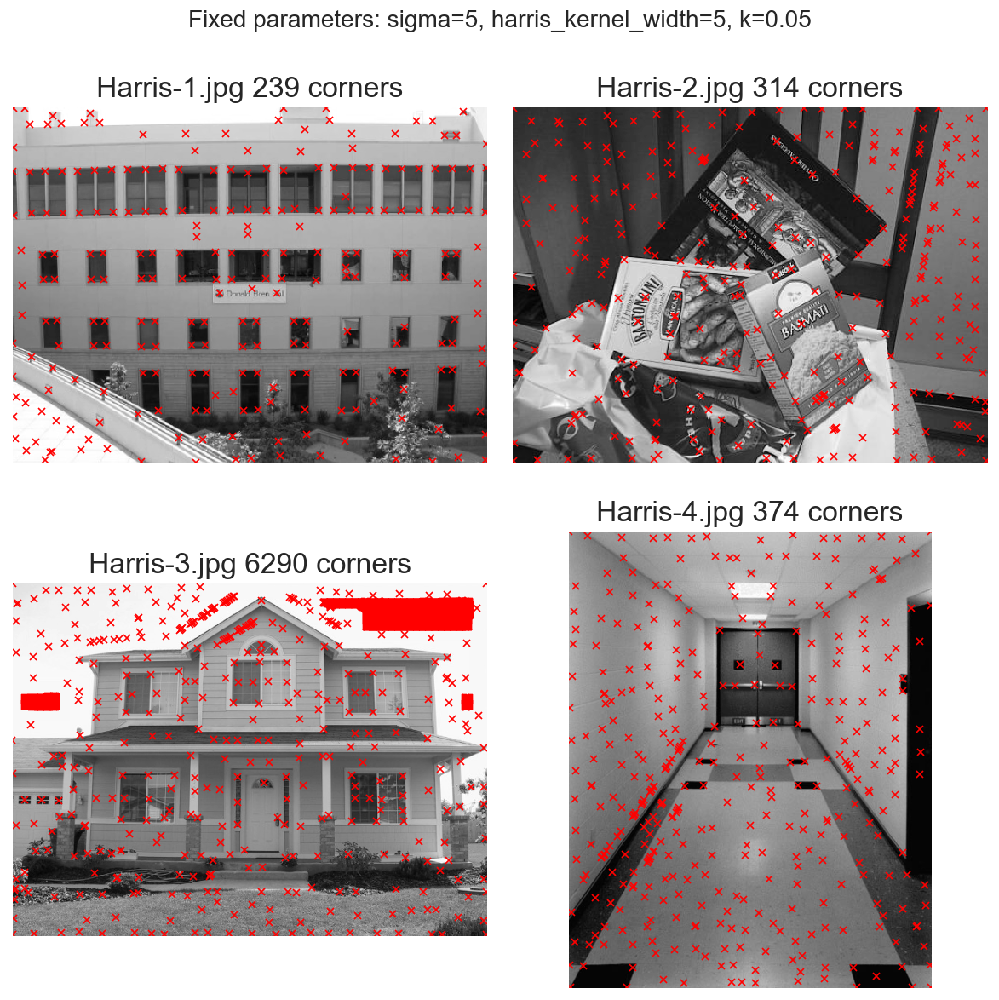

In [4]:
plt.figure(figsize=(10, 10))

plt.suptitle('Fixed parameters: sigma=5, harris_kernel_width=5, k=0.05')

for i in range(1, 5):
    img = plt.imread(f'Task1/Harris-{i}.jpg')
    
    if len(img.shape) == 3:
        img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    R = get_R(img)
    corners, Nx2 = non_maximum_suppression(R)
    
    plt.subplot(2, 2, i)
    plt.imshow(img, cmap='gray')
    plt.plot([c[1] for c in corners], [c[0] for c in corners], '.r', markersize=5, marker='x')
    plt.xticks([])
    plt.yticks([])
    plt.title(f"Harris-{i}.jpg {len(corners)} corners")
    
plt.tight_layout()

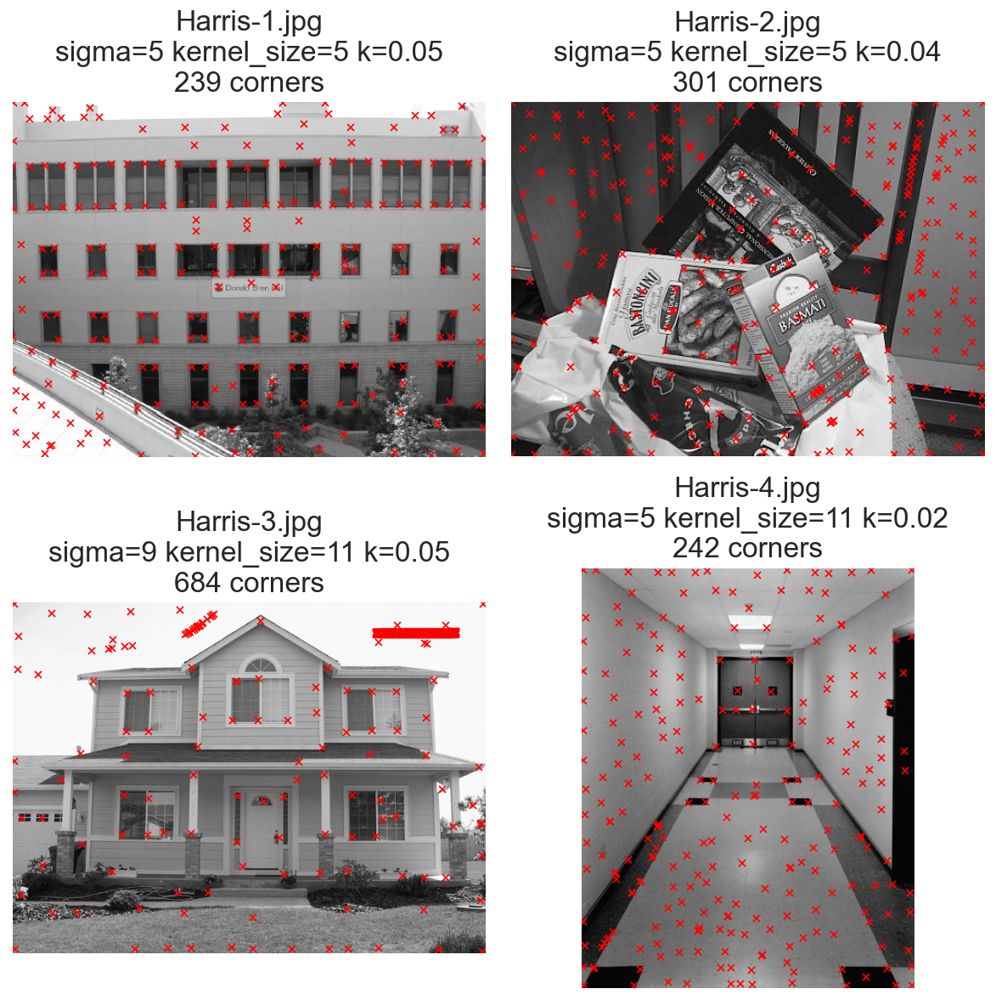

In [5]:
plt.figure(figsize=(10, 10))

# 1
fname = 'Harris-1'
img = plt.imread(f'Task1/{fname}.jpg')

if len(img.shape) == 3:
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

sigma = 5
harris_kernel_shape = (5, 5)
k = 0.05
R = get_R(img, sigma, harris_kernel_shape, k)
corners, Nx2 = non_maximum_suppression(R)

plt.subplot(2, 2, 1)
plt.imshow(img, cmap='gray')
plt.plot([c[1] for c in corners], [c[0] for c in corners], '.r', markersize=5, marker='x')
plt.xticks([])
plt.yticks([])
plt.title(f"{fname}.jpg\nsigma={sigma} kernel_size={harris_kernel_shape[0]} k={k}\n{len(corners)} corners")

# 2
fname = 'Harris-2'
img = plt.imread(f'Task1/{fname}.jpg')

if len(img.shape) == 3:
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

sigma = 5
harris_kernel_shape = (5, 5)
k = 0.04
R = get_R(img, sigma, harris_kernel_shape, k)
corners, Nx2 = non_maximum_suppression(R)

plt.subplot(2, 2, 2)
plt.imshow(img, cmap='gray')
plt.plot([c[1] for c in corners], [c[0] for c in corners], '.r', markersize=5, marker='x')
plt.xticks([])
plt.yticks([])
plt.title(f"{fname}.jpg\nsigma={sigma} kernel_size={harris_kernel_shape[0]} k={k}\n{len(corners)} corners")

# 3
fname = 'Harris-3'
img = plt.imread(f'Task1/{fname}.jpg')

if len(img.shape) == 3:
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

sigma = 9
harris_kernel_shape = (11, 11)
k = 0.05
R = get_R(img, sigma, harris_kernel_shape, k)
corners, Nx2 = non_maximum_suppression(R)

plt.subplot(2, 2, 3)
plt.imshow(img, cmap='gray')
plt.plot([c[1] for c in corners], [c[0] for c in corners], '.r', markersize=5, marker='x')
plt.xticks([])
plt.yticks([])
plt.title(f"{fname}.jpg\nsigma={sigma} kernel_size={harris_kernel_shape[0]} k={k}\n{len(corners)} corners")

# 4
fname = 'Harris-4'
img = plt.imread(f'Task1/{fname}.jpg')

if len(img.shape) == 3:
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

sigma = 5
harris_kernel_shape = (11, 11)
k = 0.02
R = get_R(img, sigma, harris_kernel_shape, k)
corners, Nx2 = non_maximum_suppression(R)

plt.subplot(2, 2, 4)
plt.imshow(img, cmap='gray')
plt.plot([c[1] for c in corners], [c[0] for c in corners], '.r', markersize=5, marker='x')
plt.xticks([])
plt.yticks([])
plt.title(f"{fname}.jpg\nsigma={sigma} kernel_size={harris_kernel_shape[0]} k={k}\n{len(corners)} corners")
    
plt.tight_layout()

## 1.5 Compare with `cv2.cornerHarris()`

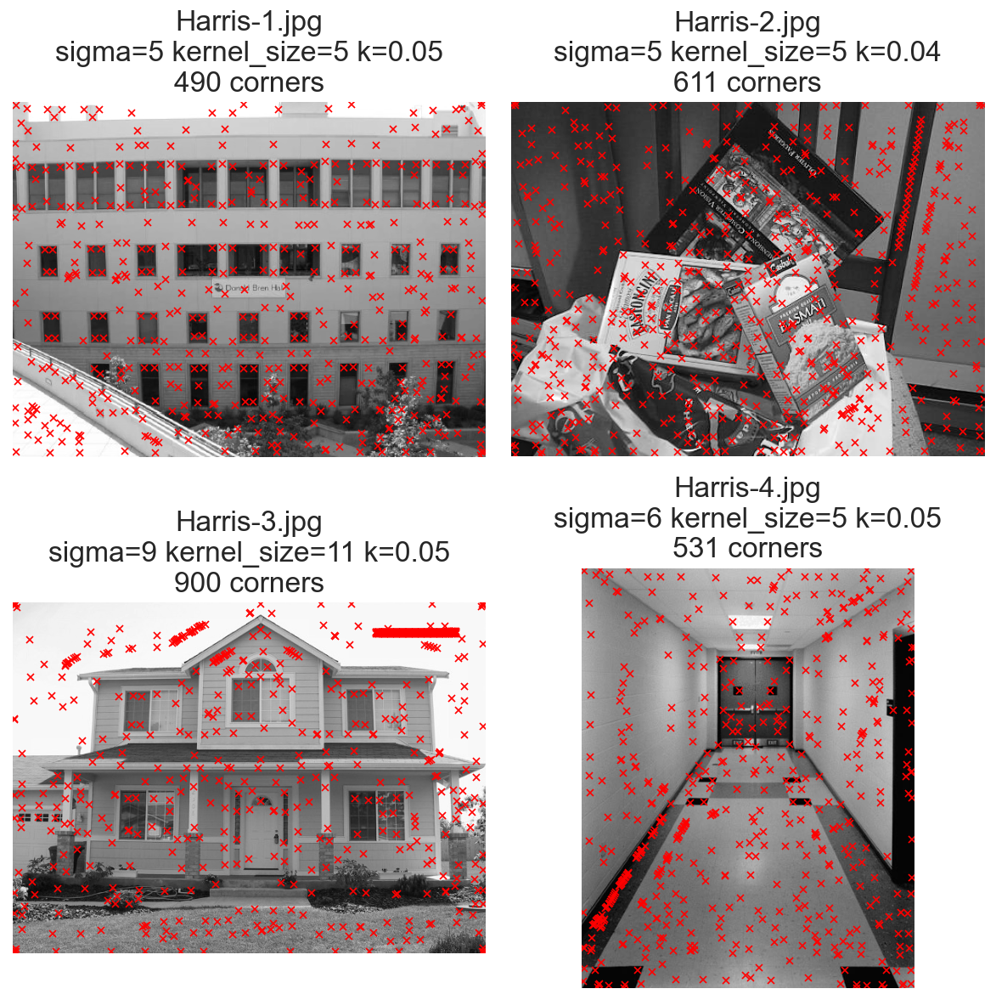

In [6]:
plt.figure(figsize=(10, 10))

# 1
fname = 'Harris-1'
img = plt.imread(f'Task1/{fname}.jpg')

if len(img.shape) == 3:
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

sigma=5
blockSize=5 # size of neighbourhood considered for corner detection
ksize=3 # size of sobel kernel
k=0.05

# gaussian filter
g = fspecial(
    (
        max(1, np.floor(3 * sigma) * 2 + 1), 
        max(1, np.floor(3 * sigma) * 2 + 1)
    ), 
    sigma
)

R = cv2.cornerHarris(conv2(img, g).astype(np.float32), blockSize=11, ksize=5, k=k)
corners, Nx2 = non_maximum_suppression(R)

plt.subplot(2, 2, 1)
plt.imshow(img, cmap='gray')
plt.plot([c[1] for c in corners], [c[0] for c in corners], '.r', markersize=5, marker='x')
plt.xticks([])
plt.yticks([])
plt.title(f"{fname}.jpg\nsigma={sigma} kernel_size={blockSize} k={k}\n{len(corners)} corners")

# 2
fname = 'Harris-2'
img = plt.imread(f'Task1/{fname}.jpg')

if len(img.shape) == 3:
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

ksize=3 # size of sobel kernel
sigma=5
blockSize=5 # size of neighbourhood considered for corner detection
k=0.04

# gaussian filter
g = fspecial(
    (
        max(1, np.floor(3 * sigma) * 2 + 1), 
        max(1, np.floor(3 * sigma) * 2 + 1)
    ), 
    sigma
)

R = cv2.cornerHarris(conv2(img, g).astype(np.float32), blockSize=11, ksize=5, k=k)
corners, Nx2 = non_maximum_suppression(R)

plt.subplot(2, 2, 2)
plt.imshow(img, cmap='gray')
plt.plot([c[1] for c in corners], [c[0] for c in corners], '.r', markersize=5, marker='x')
plt.xticks([])
plt.yticks([])
plt.title(f"{fname}.jpg\nsigma={sigma} kernel_size={blockSize} k={k}\n{len(corners)} corners")

# 3
fname = 'Harris-3'
img = plt.imread(f'Task1/{fname}.jpg')

if len(img.shape) == 3:
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

ksize=3 # size of sobel kernel
sigma=9
blockSize=11 # size of neighbourhood considered for corner detection
k=0.05

# gaussian filter
g = fspecial(
    (
        max(1, np.floor(3 * sigma) * 2 + 1), 
        max(1, np.floor(3 * sigma) * 2 + 1)
    ), 
    sigma
)

R = cv2.cornerHarris(conv2(img, g).astype(np.float32), blockSize=11, ksize=5, k=k)
corners, Nx2 = non_maximum_suppression(R)

plt.subplot(2, 2, 3)
plt.imshow(img, cmap='gray')
plt.plot([c[1] for c in corners], [c[0] for c in corners], '.r', markersize=5, marker='x')
plt.xticks([])
plt.yticks([])
plt.title(f"{fname}.jpg\nsigma={sigma} kernel_size={blockSize} k={k}\n{len(corners)} corners")

# 4
fname = 'Harris-4'
img = plt.imread(f'Task1/{fname}.jpg')

if len(img.shape) == 3:
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

ksize=3 # size of sobel kernel
sigma=6
blockSize=5 # size of neighbourhood considered for corner detection
k=0.05

# gaussian filter
g = fspecial(
    (
        max(1, np.floor(3 * sigma) * 2 + 1), 
        max(1, np.floor(3 * sigma) * 2 + 1)
    ), 
    sigma
)

R = cv2.cornerHarris(conv2(img, g).astype(np.float32), blockSize=11, ksize=5, k=k)
corners, Nx2 = non_maximum_suppression(R)

plt.subplot(2, 2, 4)
plt.imshow(img, cmap='gray')
plt.plot([c[1] for c in corners], [c[0] for c in corners], '.r', markersize=5, marker='x')
plt.xticks([])
plt.yticks([])
plt.title(f"{fname}.jpg\nsigma={sigma} kernel_size={blockSize} k={k}\n{len(corners)} corners")

plt.tight_layout()

### Factors that affect the performance of Harris corner detection

Harris corner detection is invariant to location, but not scale. As such, the performance will depend on the degree of gaussian smoothing determined by `sigma`, the kernel size of the sobel filter, the size of neighborhood considered when determining whether `img[i][j]` is a corner or not, and the `k` value in calculating the cornerness score $R$.

## 1.6 Test on Harris-5.jpg

Text(0.5, 1.0, '253001 corners')

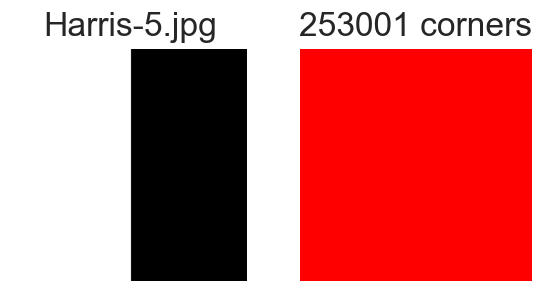

In [7]:
fname = 'Harris-5'
img = plt.imread(f'Task1/{fname}.jpg')
    
if len(img.shape) == 3:
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

sigma = 1
harris_kernel_shape = (1, 1)
k = 0.05
R = get_R(img, sigma, harris_kernel_shape, k)

corners, Nx2 = non_maximum_suppression(R)

plt.figure(figsize=(5, 10))
plt.subplot(1, 2, 1)
plt.imshow(img, cmap='gray')
plt.xticks([])
plt.yticks([])
plt.title(f"{fname}.jpg")

plt.subplot(1, 2, 2)
plt.imshow(img, cmap='gray')
plt.plot([c[1] for c in corners], [c[0] for c in corners], '.r', markersize=5, marker='x')
plt.xticks([])
plt.yticks([])
plt.title(f"{len(corners)} corners")

[]

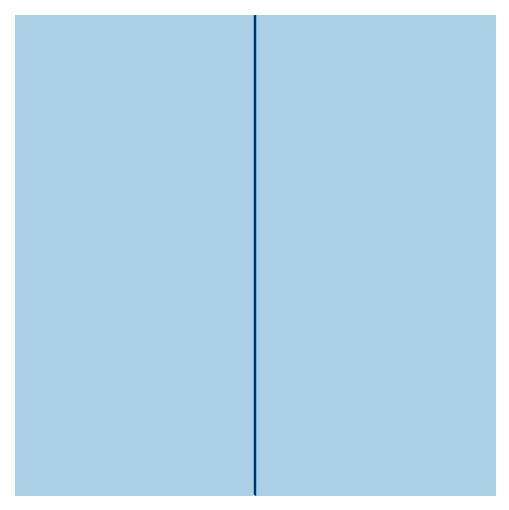

In [8]:
# visualize cornerness
fig, ax = plt.subplots(figsize=(5,5))
ax.imshow(R, cmap='RdBu_r', alpha=1)
ax.set_xticks([])
ax.set_yticks([])

<AxesSubplot:ylabel='Density'>

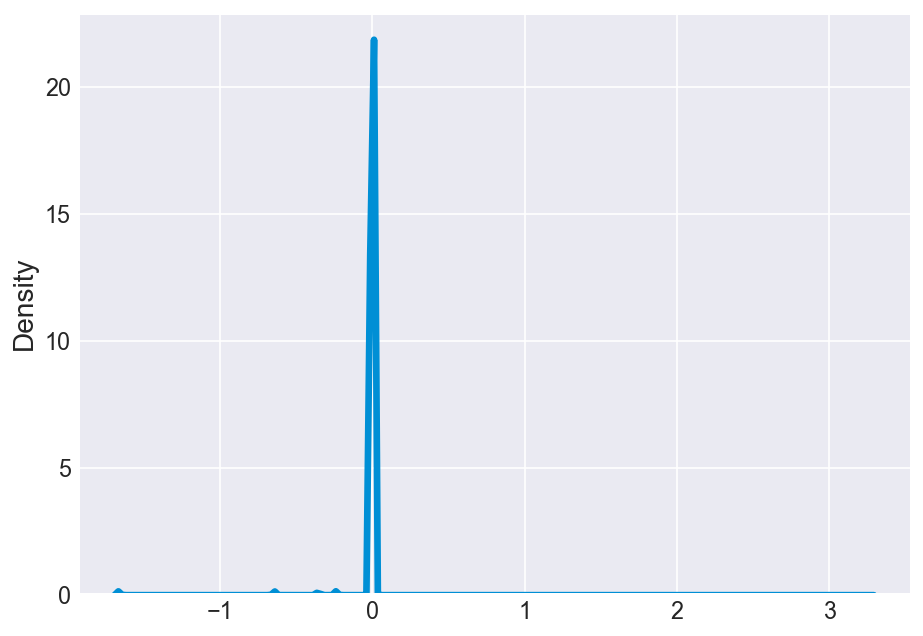

In [9]:
plt.figure(figsize=(8, 6))
sns.kdeplot(R.flatten())

In [10]:
print('Top left corner')
print(R[:3,:3])

print('Top right corner')
print(R[:3,-3:])

print('Bottom left corner')
print(R[-3:,:3])

print('Bottom right corner')
print(R[-3:,-3:])

mid = R.shape[1] // 2

print('Top center')
print(R[:3,mid-3:mid+2])

print('Bottom center')
print(R[-3:,mid-3:mid+2])

Top left corner
[[1.95029123 2.09187119 0.11344908]
 [2.09187119 2.41787998 0.51097243]
 [0.11344908 0.51097243 0.17606731]]
Top right corner
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
Bottom left corner
[[0.11344908 0.51097243 0.17606731]
 [2.09187119 2.41787998 0.51097243]
 [1.95029123 2.09187119 0.11344908]]
Bottom right corner
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
Top center
[[ 0.17165154  2.65415093  3.26432971  0.96915069  0.06661764]
 [ 0.57056862  2.97199509  3.20967762  0.64287179 -0.0273949 ]
 [ 0.19054354  0.57293854 -0.33744827 -1.04884253 -0.27012009]]
Bottom center
[[ 0.19054354  0.57293854 -0.33744827 -1.04884253 -0.27012009]
 [ 0.57056862  2.97199509  3.20967762  0.64287179 -0.0273949 ]
 [ 0.17165154  2.65415093  3.26432971  0.96915069  0.06661764]]


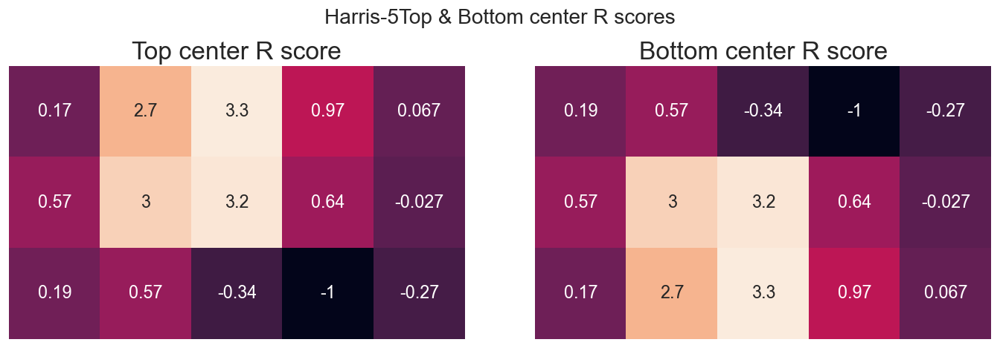

In [11]:
plt.figure(figsize=(12, 4))
plt.suptitle(fname + 'Top & Bottom center R scores')

plt.subplot(1, 2, 1)
sns.heatmap(R[:3,mid-3:mid+2], square=True, annot=True, cbar=False)
plt.xticks([])
plt.yticks([])
plt.title('Top center R score')

plt.subplot(1, 2, 2)
sns.heatmap(R[-3:,mid-3:mid+2], square=True, annot=True, cbar=False)
plt.xticks([])
plt.yticks([])
plt.title('Bottom center R score')

plt.tight_layout()

### Analyse the results why we cannot get corners by discussing and visualising your corner response scores of the image.

R value is approximately 0 for almost all pixel positions in the image. The only pixels with high R scores are at top and bottom left corners, and top and bottom center because the right half of the image is all 0s. Corners were detected on the left corners only because of the 0 padding of width 1 that's applied to the image in `conv2()` function. Corners were also detected in the top and bottom center because of the boundary between the white and black regions, in addition to the 0 padding. Aside from the influence from 0 padding, no corners were detected because there are no corners in the image.

    Top left corner
    [[1.95029123 2.09187119 0.11344908]
     [2.09187119 2.41787998 0.51097243]
     [0.11344908 0.51097243 0.17606731]]
     
    Top right corner
    [[0. 0. 0.]
     [0. 0. 0.]
     [0. 0. 0.]]
     
    Bottom left corner
    [[0.11344908 0.51097243 0.17606731]
     [2.09187119 2.41787998 0.51097243]
     [1.95029123 2.09187119 0.11344908]]
     
    Bottom right corner
    [[0. 0. 0.]
     [0. 0. 0.]
     [0. 0. 0.]]
     
    Top center
    [[ 0.17165154  2.65415093  3.26432971  0.96915069  0.06661764]
     [ 0.57056862  2.97199509  3.20967762  0.64287179 -0.0273949 ]
     [ 0.19054354  0.57293854 -0.33744827 -1.04884253 -0.27012009]]
     
    Bottom center
    [[ 0.19054354  0.57293854 -0.33744827 -1.04884253 -0.27012009]
     [ 0.57056862  2.97199509  3.20967762  0.64287179 -0.0273949 ]
     [ 0.17165154  2.65415093  3.26432971  0.96915069  0.06661764]]

## 1.7 Test on Harris-6.jpg

In [12]:
fname = 'Harris-6'
img = plt.imread(f'Task1/{fname}.jpg')

if len(img.shape) == 3:
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

Text(0.5, 1.0, 'Harris-6.jpg 37761 corners')

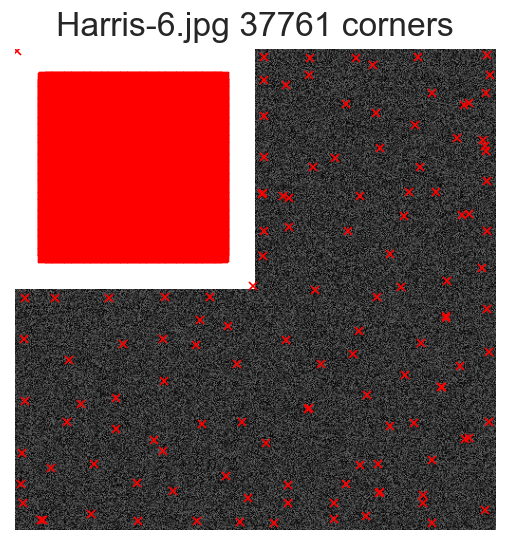

In [13]:
sigma = 10
harris_kernel_shape = (1, 1)
k = 0.04
R = get_R(img, sigma, harris_kernel_shape, k)

corners, Nx2 = non_maximum_suppression(R)

fig, ax = plt.subplots(figsize=(5,5))
ax.imshow(img, cmap='gray')
ax.plot([c[1] for c in corners], [c[0] for c in corners], '.r', markersize=5, marker='x')
plt.xticks([])
plt.yticks([])
plt.title(f"{fname}.jpg {len(corners)} corners")

# Task 2: KMeans

In [14]:
img = plt.imread('Task2/mandm.png')
img2 = plt.imread('Task2/peppers.png')
scaler = MinMaxScaler()

In [15]:
print(img.shape)

if not all(img.max((0, 1)) == 1):
    print('converting')
    img /= 255
    
img.max((0,1))

(394, 451, 3)


array([1., 1., 1.], dtype=float32)

In [16]:
print(img2.shape)

if not all(img2.max((0, 1)) == 1):
    print('converting')
    img2 /= 255
    
img2.max((0,1))

(384, 512, 3)


array([1., 1., 1.], dtype=float32)

In [17]:
img_lab = cv2.cvtColor(img, cv2.COLOR_RGB2Lab)

data = []
for i in range(len(img_lab)):
    for j in range(len(img_lab[0])):
        l, a, b = img_lab[i][j]
        data += (l, a, b, i, j),
        
data = np.array(data)
data = scaler.fit_transform(data)
assert all(data.max(0) == 1) and all(data.min(0) == 0)

In [18]:
img_lab = cv2.cvtColor(img2, cv2.COLOR_RGB2Lab)

data2 = []
for i in range(len(img_lab)):
    for j in range(len(img_lab[0])):
        l, a, b = img_lab[i][j]
        data2 += (l, a, b, i, j),
        
data2 = np.array(data2)
data2 = scaler.fit_transform(data2)
print(data2.max(0))
print(data2.min(0))

[1. 1. 1. 1. 1.]
[0. 0. 0. 0. 0.]


## Naive KMeans

In [19]:
class KMeans:
    def __init__(self, X: np.ndarray, k: int):
        """initialize parameters and randomly create centroids in the domain of input data"""
        self.X = X
        self.k = k
        self.centroids = np.random.uniform(size=(self.k, self.X.shape[1]))
        self.pred = np.zeros(X.shape[0])

    @staticmethod
    def euclidean_distance(X, centroids):
        """calculate pair-wise euclidean distance"""
        k = centroids.shape[0]
        
        diff = X[np.newaxis,:,:] - centroids[:,np.newaxis,:]        
        assert diff.shape == (k, X.shape[0], X.shape[1])

        dist = np.sqrt(np.sum(diff**2, axis=-1))
        dist = dist.transpose()
        assert dist.shape == (X.shape[0], k)
        
        return dist
        
    def predict(self, verbose=False):
        i = 1
        start_time = time.time()
        
        while True:
            # calculate distance between every point and every centroid
            dist = KMeans.euclidean_distance(self.X, self.centroids)
            
            # assign each point to a class with nearest centroid
            pred = np.argmin(dist, axis=1)

            # calculate new centroid and wss for each cluster
            new_centroids = []
            wss = []
            for c in range(self.k):
                if len(self.X[pred==c]) == 0:
                    new_centroid = np.random.uniform(size=self.centroids.shape[1])
                else:
                    new_centroid = np.mean(self.X[pred==c], axis=0)
                new_centroids += new_centroid,

                # within-cluster sum of squared difference
                wss += np.sum((self.X[pred==c] - new_centroid) ** 2),

            new_centroids = np.array(new_centroids)
            assert self.centroids.shape == new_centroids.shape
            self.centroids = new_centroids
            self.wss = np.array(wss)
                        
            if all(pred == self.pred):
                return time.time() - start_time
            else:                    
                if i % 5 == 0 and verbose:
                    elapsed = time.time() - start_time
                    print(f'iteration: {i:>3}\twss: {self.wss.sum():^10.2f}\ttime in seconds: {elapsed:>5.2f}')
                    
                last_wss = self.wss
                self.pred = pred
                i += 1
                
def my_kmeans(data, start, end):
    scores = []
    models = []
    conv_time = []
    
    assert start < end
    
    for k in range(start, end):
        kmeans = KMeans(data, k=k)
        t_elapsed = kmeans.predict()
            
        wss = kmeans.wss.sum()
        scores += wss,
        models += kmeans,
        conv_time += t_elapsed,
    return np.array(scores), conv_time

In [20]:
start, end = (3, 11)

### KMeans using pixel coordinates

#### Image 1: M&M

In [21]:
scores, conv_time = my_kmeans(data, start=start, end=end)
conv_time_kmeans_mandm = conv_time

Text(0.5, 1.0, 'Within-Cluster Sum of Squared Error (Var)')

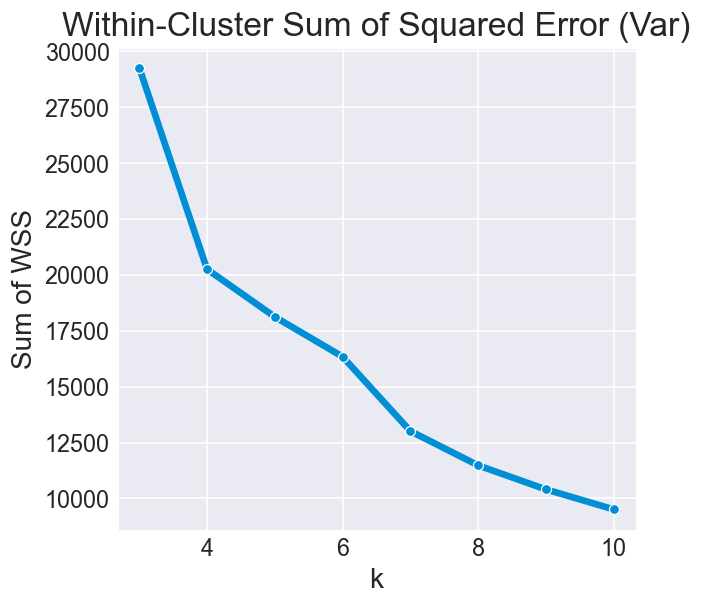

In [22]:
fig, ax = plt.subplots(figsize=(5,5))
sns.lineplot(x=np.arange(start, end), y=scores, ax=ax, marker='o')
plt.xlabel('k')
plt.ylabel('Sum of WSS')
plt.title('Within-Cluster Sum of Squared Error (Var)')

iteration:   5	wss:  11836.85 	time in seconds:  0.72
iteration:  10	wss:  11788.13 	time in seconds:  1.27
iteration:  15	wss:  11787.33 	time in seconds:  1.88
iteration:  20	wss:  11787.13 	time in seconds:  2.50
iteration:  25	wss:  11787.07 	time in seconds:  3.10
iteration:  30	wss:  11787.06 	time in seconds:  3.73
iteration:  35	wss:  11787.06 	time in seconds:  4.37
iteration:  40	wss:  11787.06 	time in seconds:  4.97


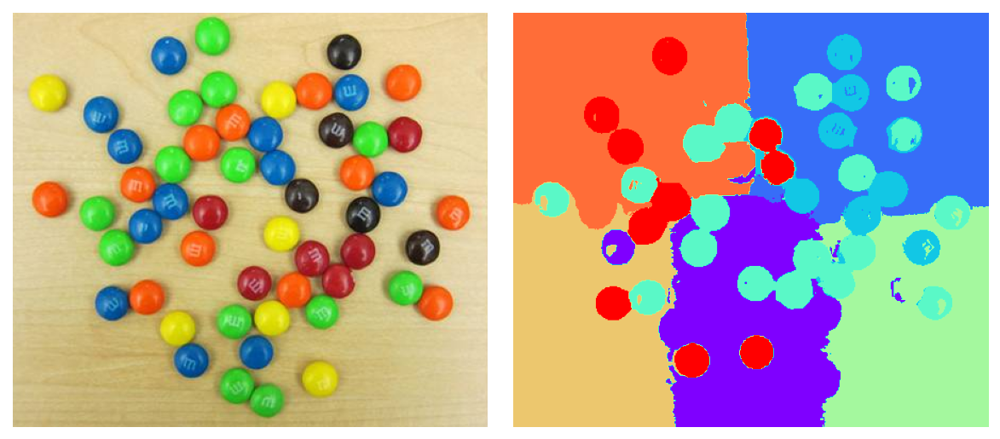

In [23]:
kmeans = KMeans(data, k=8)
kmeans.predict(verbose=True)
pred = kmeans.pred.reshape((img.shape[0], -1))

fig, axes = plt.subplots(1, 2, figsize=(10,5))

axes[0].imshow(img)
axes[0].grid(False)
axes[0].set_xticks([])
axes[0].set_yticks([])

axes[1].imshow(pred, cmap='rainbow')
axes[1].grid(False)
axes[1].set_xticks([])
axes[1].set_yticks([])

plt.tight_layout()

#### Image 2: Peppers

In [24]:
scores, conv_time = my_kmeans(data2, start=start, end=end)
conv_time_kmeans_peppers = conv_time

Text(0.5, 1.0, 'Within-Cluster Sum of Squared Error (Var)')

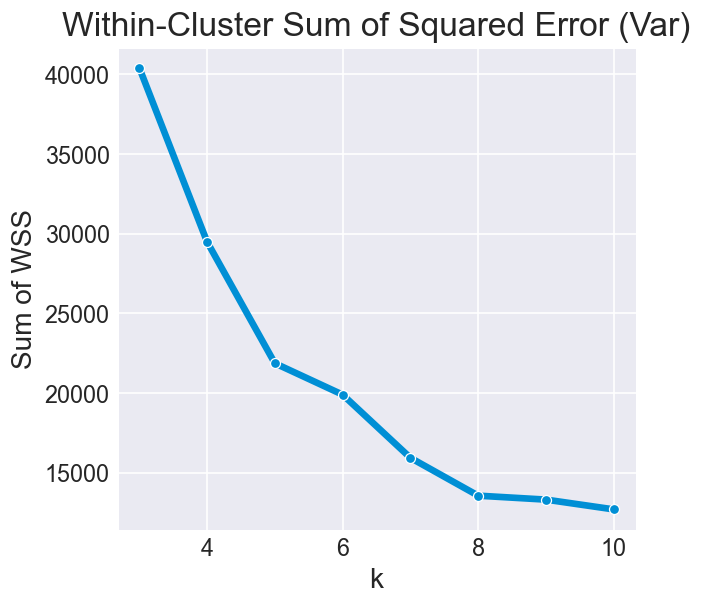

In [25]:
fig, ax = plt.subplots(figsize=(5,5))
sns.lineplot(x=np.arange(start, end), y=scores, ax=ax, marker='o')
plt.xlabel('k')
plt.ylabel('Sum of WSS')
plt.title('Within-Cluster Sum of Squared Error (Var)')

iteration:   5	wss:  19380.95 	time in seconds:  0.63
iteration:  10	wss:  18678.02 	time in seconds:  1.21
iteration:  15	wss:  16876.94 	time in seconds:  1.92
iteration:  20	wss:  16739.23 	time in seconds:  2.48
iteration:  25	wss:  16573.13 	time in seconds:  3.19
iteration:  30	wss:  16469.44 	time in seconds:  3.72
iteration:  35	wss:  16446.45 	time in seconds:  4.26
iteration:  40	wss:  16446.33 	time in seconds:  4.82


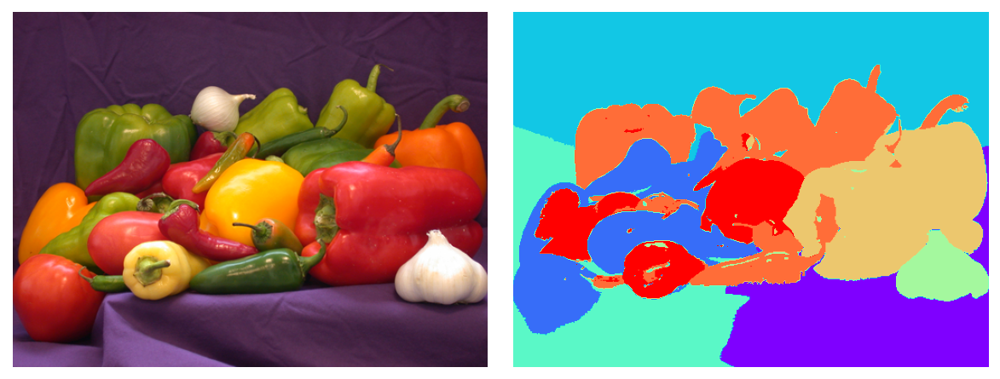

In [26]:
kmeans = KMeans(data2, k=8)
kmeans.predict(verbose=True)
pred = kmeans.pred.reshape((img2.shape[0], -1))

fig, axes = plt.subplots(1, 2, figsize=(10,5))

axes[0].imshow(img2)
axes[0].grid(False)
axes[0].set_xticks([])
axes[0].set_yticks([])

axes[1].imshow(pred, cmap='rainbow')
axes[1].grid(False)
axes[1].set_xticks([])
axes[1].set_yticks([])

plt.tight_layout()

### KMeans without using pixel coordinates

#### Image 1: M&M

In [27]:
scores, conv_time = my_kmeans(data[:,:3], start=start, end=end)

Text(0.5, 1.0, 'Within-Cluster Sum of Squared Error (Var)')

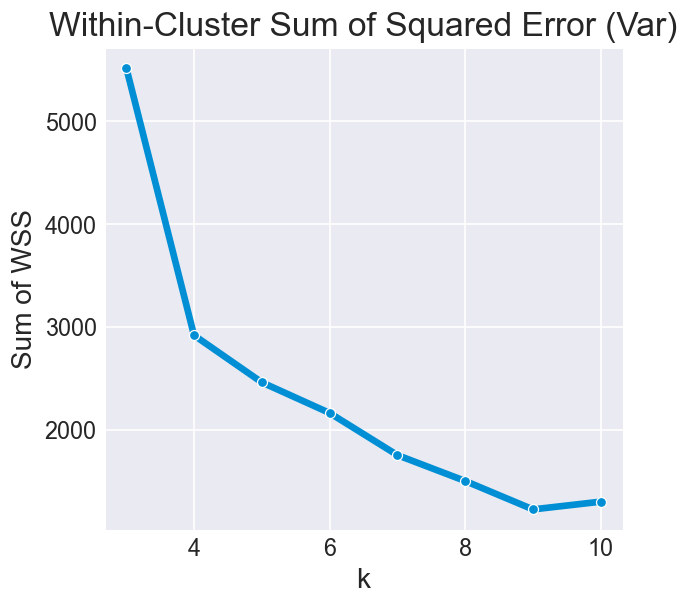

In [28]:
fig, ax = plt.subplots(figsize=(5,5))
sns.lineplot(x=np.arange(start, end), y=scores, ax=ax, marker='o')
plt.xlabel('k')
plt.ylabel('Sum of WSS')
plt.title('Within-Cluster Sum of Squared Error (Var)')

iteration:   5	wss:  1799.11  	time in seconds:  0.49
iteration:  10	wss:  1755.90  	time in seconds:  0.89
iteration:  15	wss:  1752.63  	time in seconds:  1.29
iteration:  20	wss:  1752.19  	time in seconds:  1.69
iteration:  25	wss:  1752.09  	time in seconds:  2.09
iteration:  30	wss:  1752.08  	time in seconds:  2.52


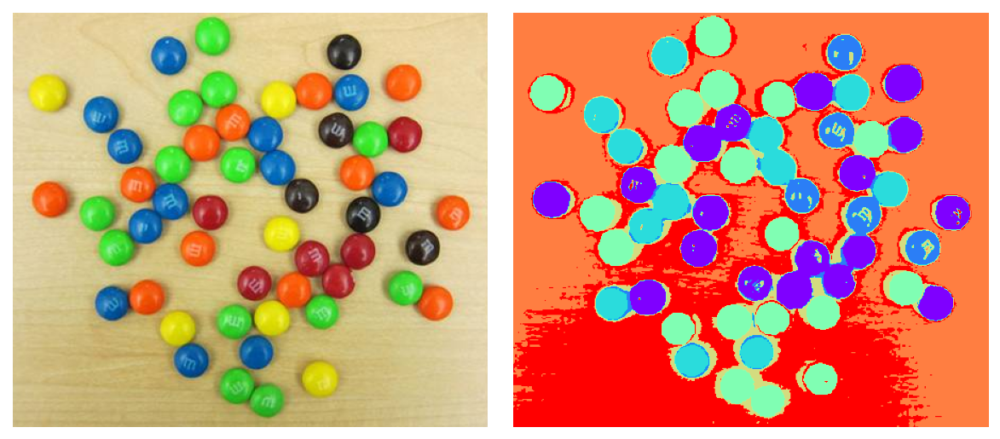

In [29]:
kmeans = KMeans(data[:, :3], k=7)
kmeans.predict(verbose=True)
pred = kmeans.pred.reshape((img.shape[0], -1))

fig, axes = plt.subplots(1, 2, figsize=(10,5))

axes[0].imshow(img)
axes[0].grid(False)
axes[0].set_xticks([])
axes[0].set_yticks([])

axes[1].imshow(pred, cmap='rainbow')
axes[1].grid(False)
axes[1].set_xticks([])
axes[1].set_yticks([])

plt.tight_layout()

#### Image 2: Peppers

In [30]:
scores, conv_time = my_kmeans(data2[:,:3], start=start, end=end)

Text(0.5, 1.0, 'Within-Cluster Sum of Squared Error (Var)')

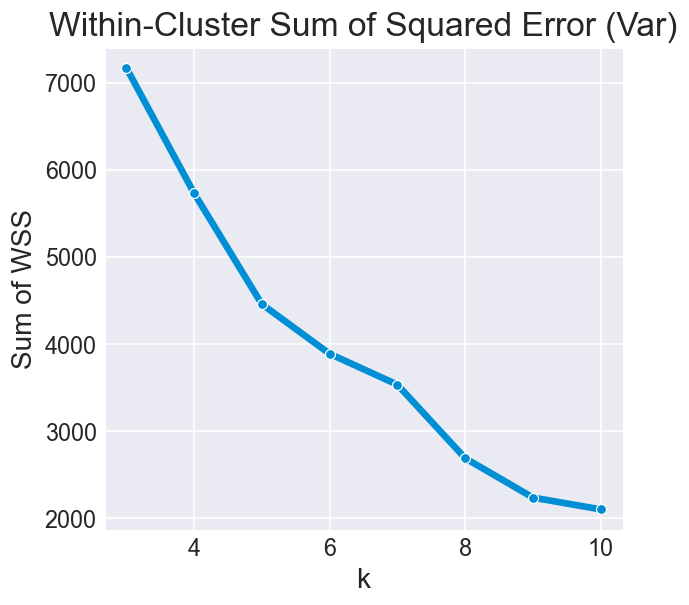

In [31]:
fig, ax = plt.subplots(figsize=(5,5))
sns.lineplot(x=np.arange(start, end), y=scores, ax=ax, marker='o')
plt.xlabel('k')
plt.ylabel('Sum of WSS')
plt.title('Within-Cluster Sum of Squared Error (Var)')

iteration:   5	wss:  3659.46  	time in seconds:  0.68
iteration:  10	wss:  3606.01  	time in seconds:  1.23
iteration:  15	wss:  3603.82  	time in seconds:  1.79
iteration:  20	wss:  3603.69  	time in seconds:  2.32
iteration:  25	wss:  3603.67  	time in seconds:  2.78
iteration:  30	wss:  3603.66  	time in seconds:  3.40
iteration:  35	wss:  3603.66  	time in seconds:  3.92


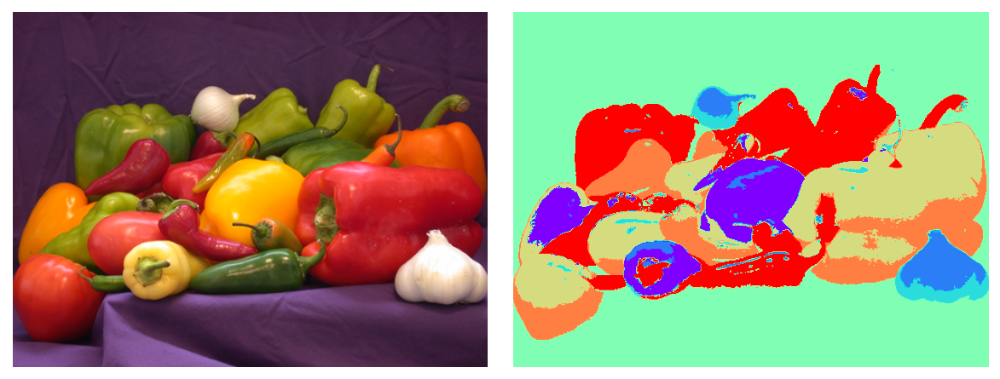

In [32]:
kmeans = KMeans(data2[:, :3], k=7)
kmeans.predict(verbose=True)
pred = kmeans.pred.reshape((img2.shape[0], -1))

fig, axes = plt.subplots(1, 2, figsize=(10,5))

axes[0].imshow(img2)
axes[0].grid(False)
axes[0].set_xticks([])
axes[0].set_yticks([])

axes[1].imshow(pred, cmap='rainbow')
axes[1].grid(False)
axes[1].set_xticks([])
axes[1].set_yticks([])

plt.tight_layout()

## KMeans++

http://ilpubs.stanford.edu:8090/778/1/2006-13.pdf

### Summary of key differences

The key difference between (Naive) KMeans and KMeans++ is in the initialization of the centroids.
While KMeans randomly initializes centroids in the input data space using uniform distribution, KMeans++ randomly picks one data point as the first centroid, and picks the rest of k-1 centroids by choosing the data point that is most distant from the closest centroid.

In [33]:
class KMeansPP:
    def __init__(self, X: np.ndarray, k: int):
        self.X = X
        self.k = k
        self.initialize_centroids()
        self.pred = np.zeros(self.X.shape[0])

    @staticmethod
    def euclidean_distance(X, centroids):
        """calculate pair-wise euclidean distance"""
        k = centroids.shape[0]
        
        diff = X[np.newaxis,:,:] - centroids[:,np.newaxis,:]        
        assert diff.shape == (k, X.shape[0], X.shape[1])

        dist = np.sqrt(np.sum(diff**2, axis=-1))
        dist = dist.transpose()
        assert dist.shape == (X.shape[0], k)
        
        return dist

    def initialize_centroids(self):
        X = copy.deepcopy(self.X)
        idx = np.random.randint(low=0, high=X.shape[0])
        centroid = X[idx]
        centroids = np.array([centroid])
        X = np.delete(X, idx, 0)
        
        for i in range(1, self.k):
            # calculate distance to the nearest centroid for all points that are not used as a centroid
            dist = KMeansPP.euclidean_distance(X, centroids)
            dist_to_nearest_centroid = np.min(dist, 1)
            
            # use the point furthest from the nearest cluster as the next centroid
            idx = np.argmax(dist_to_nearest_centroid ** 2)
            centroid = X[idx]
            centroids = np.vstack((centroids, centroid))
            X = np.delete(X, idx, 0)
            
        self.centroids = centroids

    def predict(self, verbose=False):
        i = 1
        start_time = time.time()
        
        while True:
            # calculate distance between every point and every centroid
            dist = KMeans.euclidean_distance(self.X, self.centroids)
            
            # assign each point to a class with nearest centroid
            pred = np.argmin(dist, axis=1)

            # calculate new centroid and wss for each cluster
            new_centroids = []
            wss = []
            for c in range(self.k):
                if len(self.X[pred==c]) == 0:
                    new_centroid = np.random.uniform(size=self.centroids.shape[1])
                else:
                    new_centroid = np.mean(self.X[pred==c], axis=0)
                new_centroids += new_centroid,

                # within-cluster sum of squared difference
                wss += np.sum((self.X[pred==c] - new_centroid) ** 2),

            new_centroids = np.array(new_centroids)
            assert self.centroids.shape == new_centroids.shape
            self.centroids = new_centroids
            self.wss = np.array(wss)
                        
            if all(pred == self.pred):
                return time.time() - start_time
            else:                    
                if i % 5 == 0 and verbose:
                    elapsed = time.time() - start_time
                    print(f'iteration: {i:>3}\twss: {self.wss.sum():^10.2f}\ttime in seconds: {elapsed:>5.2f}')
                    
                self.pred = pred
                i += 1

def my_kmeanspp(data, start, end):
    scores = []
    models = []
    conv_time = []
    
    assert start < end
    
    for k in range(start, end):        
        kmeanspp = KMeansPP(data, k=k)
        t_elapsed = kmeanspp.predict()
            
        wss = kmeanspp.wss.sum()
        scores += wss,
        models += kmeanspp,
        conv_time += t_elapsed,
    return np.array(scores), conv_time

### inspect centroid initialization

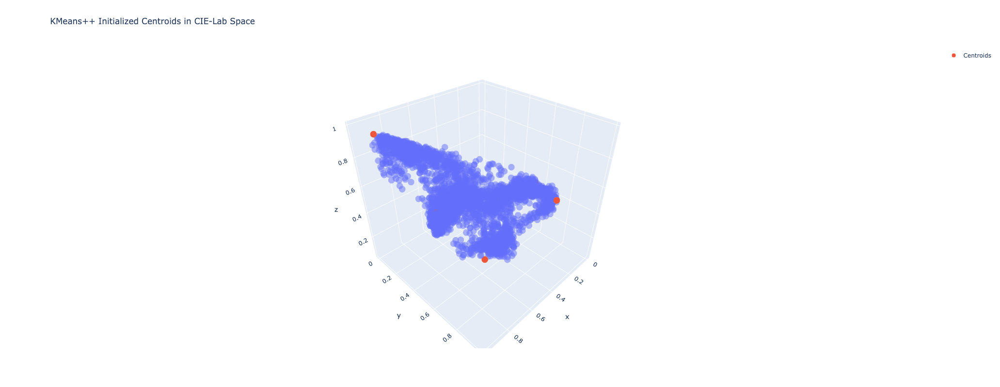

In [34]:
kmeanspp = KMeansPP(data[:, :3], k=5)
centroids = kmeanspp.centroids
frac = 0.05
n = int(data.shape[0] * frac)
sample_idx = np.random.choice(data.shape[0], n, replace=False)
sample = data[sample_idx, :]
fig = px.scatter_3d(x=sample[:,0], y=sample[:,1], z=sample[:,2], opacity=0.5, 
                    width=1000, height=800, title='KMeans++ Initialized Centroids in CIE-Lab Space')
fig.add_scatter3d(x=centroids[:,0], y=centroids[:,1], z=centroids[:,2], opacity=1, mode='markers', name='Centroids')

### Test model on data with pixel coordinates

#### Image 1: M&M

In [35]:
scores, conv_time = my_kmeanspp(data, start=start, end=end)
score_with_xy_mandm = scores
conv_time_kmeanspp_mandm = conv_time

Text(0.5, 1.0, 'Within-Cluster Sum of Squared Error (Var)')

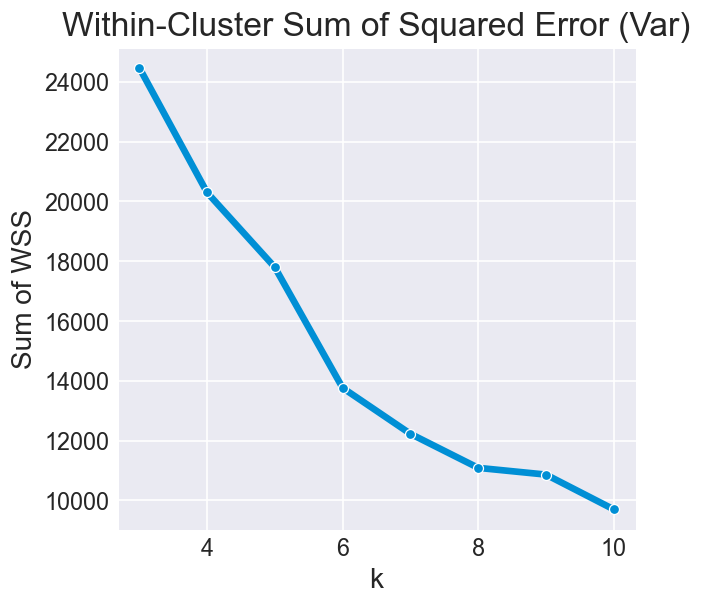

In [36]:
fig, ax = plt.subplots(figsize=(5,5))
sns.lineplot(x=np.arange(start, end), y=scores, ax=ax, marker='o')
plt.xlabel('k')
plt.ylabel('Sum of WSS')
plt.title('Within-Cluster Sum of Squared Error (Var)')

iteration:   5	wss:  13082.72 	time in seconds:  0.62
iteration:  10	wss:  13010.83 	time in seconds:  1.26
iteration:  15	wss:  13010.31 	time in seconds:  1.89
iteration:  20	wss:  13010.31 	time in seconds:  2.44


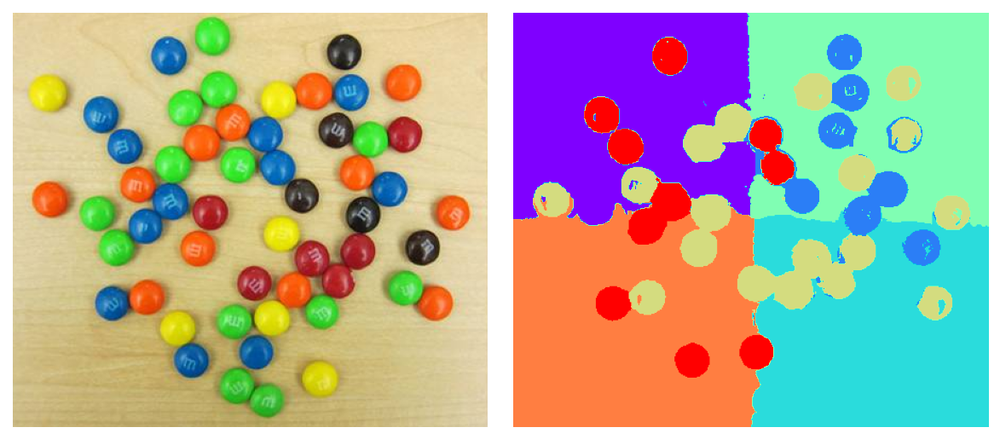

In [37]:
kmeanspp = KMeansPP(data, k=7)
kmeanspp.predict(verbose=True)
pred = kmeanspp.pred.reshape((img.shape[0], -1))

fig, axes = plt.subplots(1, 2, figsize=(10,5))

axes[0].imshow(img)
axes[0].grid(False)
axes[0].set_xticks([])
axes[0].set_yticks([])

axes[1].imshow(pred, cmap='rainbow')
axes[1].grid(False)
axes[1].set_xticks([])
axes[1].set_yticks([])

plt.tight_layout()

#### Image 2: Peppers

In [38]:
scores, conv_time = my_kmeanspp(data2, start=start, end=end)
score_with_xy_peppers = scores
conv_time_kmeanspp_peppers = conv_time

Text(0.5, 1.0, 'Within-Cluster Sum of Squared Error (Var)')

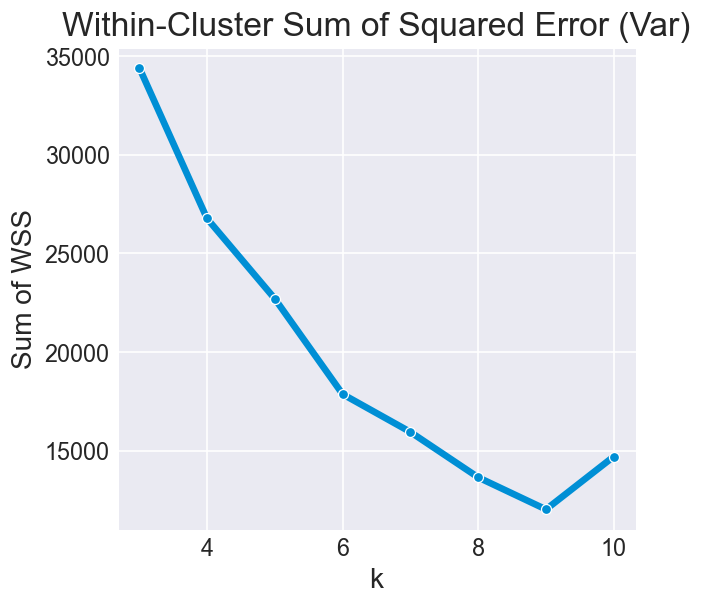

In [39]:
fig, ax = plt.subplots(figsize=(5,5))
sns.lineplot(x=np.arange(start, end), y=scores, ax=ax, marker='o')
plt.xlabel('k')
plt.ylabel('Sum of WSS')
plt.title('Within-Cluster Sum of Squared Error (Var)')

iteration:   5	wss:  14715.05 	time in seconds:  0.67
iteration:  10	wss:  14105.67 	time in seconds:  1.38
iteration:  15	wss:  13639.19 	time in seconds:  2.20
iteration:  20	wss:  13638.55 	time in seconds:  2.99


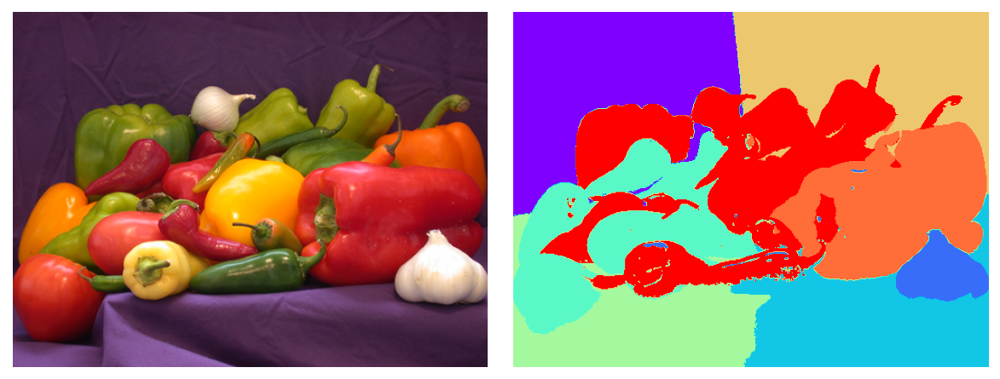

In [40]:
kmeanspp = KMeansPP(data2, k=8)
kmeanspp.predict(verbose=True)
pred = kmeanspp.pred.reshape((img2.shape[0], -1))

fig, axes = plt.subplots(1, 2, figsize=(10,5))

axes[0].imshow(img2)
axes[0].grid(False)
axes[0].set_xticks([])
axes[0].set_yticks([])

axes[1].imshow(pred, cmap='rainbow')
axes[1].grid(False)
axes[1].set_xticks([])
axes[1].set_yticks([])

plt.tight_layout()

### Test model on data without pixel coordinates

#### Image 1: M&M

In [41]:
scores, models = my_kmeanspp(data[:,:3], start=start, end=end)
score_without_xy_mandm = scores

Text(0.5, 1.0, 'Within-Cluster Sum of Squared Error (Var)')

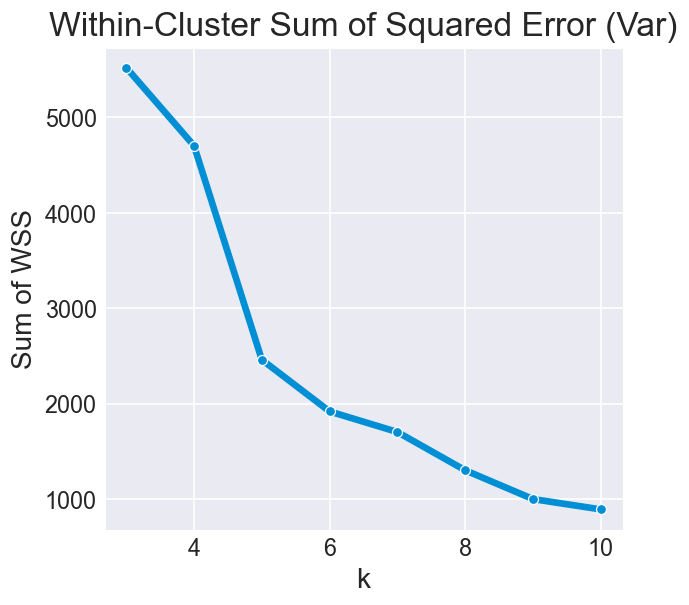

In [42]:
fig, ax = plt.subplots(figsize=(5,5))
sns.lineplot(x=np.arange(start, end), y=scores, ax=ax, marker='o')
plt.xlabel('k')
plt.ylabel('Sum of WSS')
plt.title('Within-Cluster Sum of Squared Error (Var)')

iteration:   5	wss:  3926.00  	time in seconds:  0.44
iteration:  10	wss:  1863.21  	time in seconds:  0.90
iteration:  15	wss:  1630.13  	time in seconds:  1.49
iteration:  20	wss:  1617.34  	time in seconds:  2.00
iteration:  25	wss:  1617.22  	time in seconds:  2.41
iteration:  30	wss:  1617.22  	time in seconds:  2.80


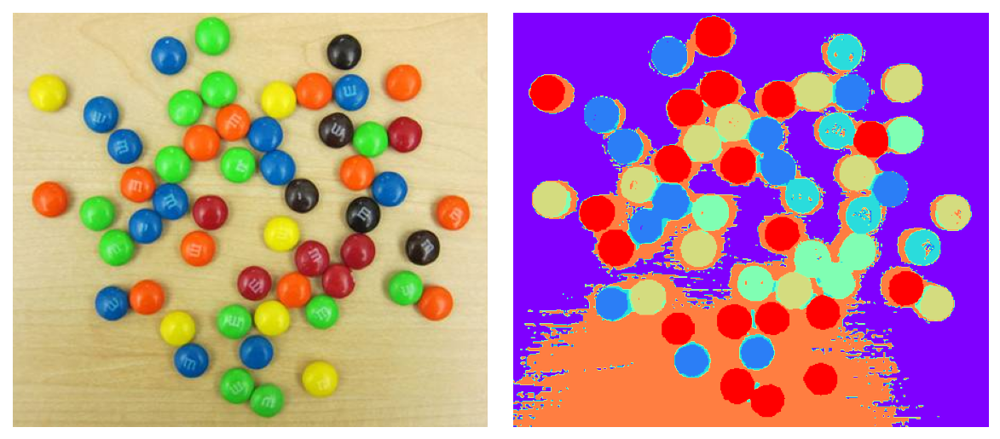

In [43]:
kmeanspp = KMeans(data[:, :3], k=7)
kmeanspp.predict(verbose=True)
pred = kmeanspp.pred.reshape((img.shape[0], -1))

fig, axes = plt.subplots(1, 2, figsize=(10,5))

axes[0].imshow(img)
axes[0].grid(False)
axes[0].set_xticks([])
axes[0].set_yticks([])

axes[1].imshow(pred, cmap='rainbow')
axes[1].grid(False)
axes[1].set_xticks([])
axes[1].set_yticks([])

plt.tight_layout()

#### Image 2: Peppers

In [44]:
scores, models = my_kmeanspp(data2[:,:3], start=start, end=end)
score_without_xy_peppers = scores

Text(0.5, 1.0, 'Within-Cluster Sum of Squared Error (Var)')

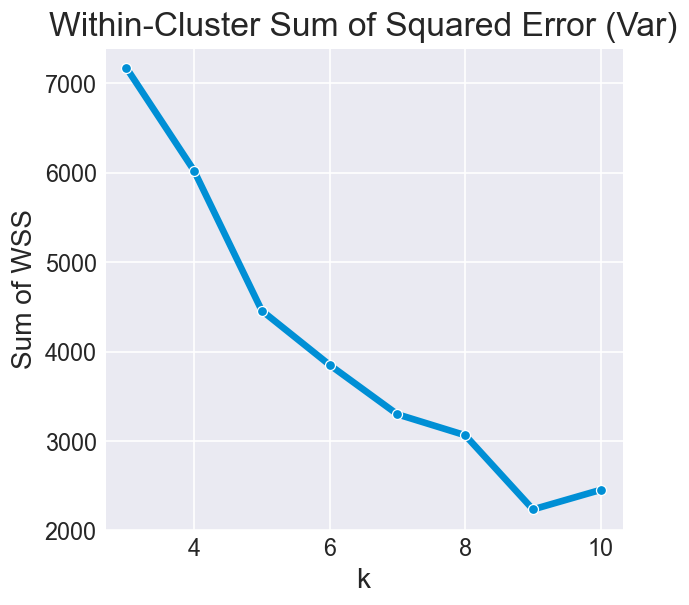

In [45]:
fig, ax = plt.subplots(figsize=(5,5))
sns.lineplot(x=np.arange(start, end), y=scores, ax=ax, marker='o')
plt.xlabel('k')
plt.ylabel('Sum of WSS')
plt.title('Within-Cluster Sum of Squared Error (Var)')

iteration:   5	wss:  3367.24  	time in seconds:  0.49
iteration:  10	wss:  3300.79  	time in seconds:  0.95
iteration:  15	wss:  3298.56  	time in seconds:  1.58
iteration:  20	wss:  3298.27  	time in seconds:  2.09
iteration:  25	wss:  3298.23  	time in seconds:  2.60
iteration:  30	wss:  3298.22  	time in seconds:  3.10
iteration:  35	wss:  3298.22  	time in seconds:  3.62


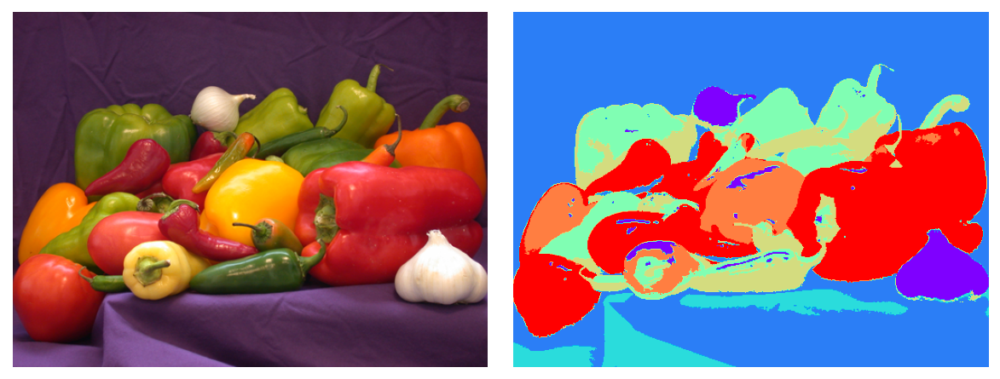

In [46]:
kmeanspp = KMeans(data2[:, :3], k=7)
kmeanspp.predict(verbose=True)
pred = kmeanspp.pred.reshape((img2.shape[0], -1))

fig, axes = plt.subplots(1, 2, figsize=(10,5))

axes[0].imshow(img2)
axes[0].grid(False)
axes[0].set_xticks([])
axes[0].set_yticks([])

axes[1].imshow(pred, cmap='rainbow')
axes[1].grid(False)
axes[1].set_xticks([])
axes[1].set_yticks([])

plt.tight_layout()

### KMeans++ Misc Evaluation

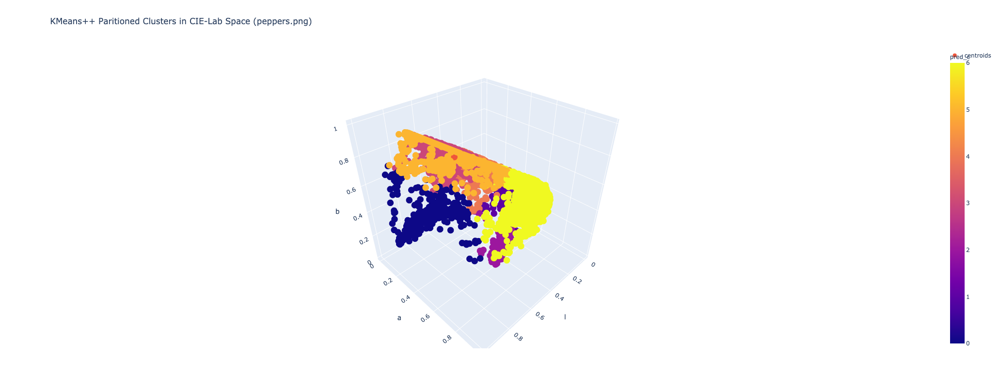

In [47]:
centroids = kmeanspp.centroids
frac = 0.05
n = int(data2.shape[0] * frac)
sample_idx = np.random.choice(data2.shape[0], n, replace=False)

df = pd.DataFrame(np.hstack([data2, kmeanspp.pred.reshape((-1, 1))]))
df.columns = ['l', 'a', 'b', 'y', 'x', 'pred_c']
df['pred_c'] = df['pred_c'].astype(int)
sample_df = df.iloc[sample_idx]

fig = px.scatter_3d(sample_df, x='l', y='a', z='b', color='pred_c', opacity=1, 
                    width=1000, height=800, 
                    title='KMeans++ Paritioned Clusters in CIE-Lab Space (peppers.png)')

fig = fig.add_scatter3d(x=centroids[:,0], y=centroids[:,1], z=centroids[:,2], opacity=1, mode='markers', name='centroids')
fig.show()

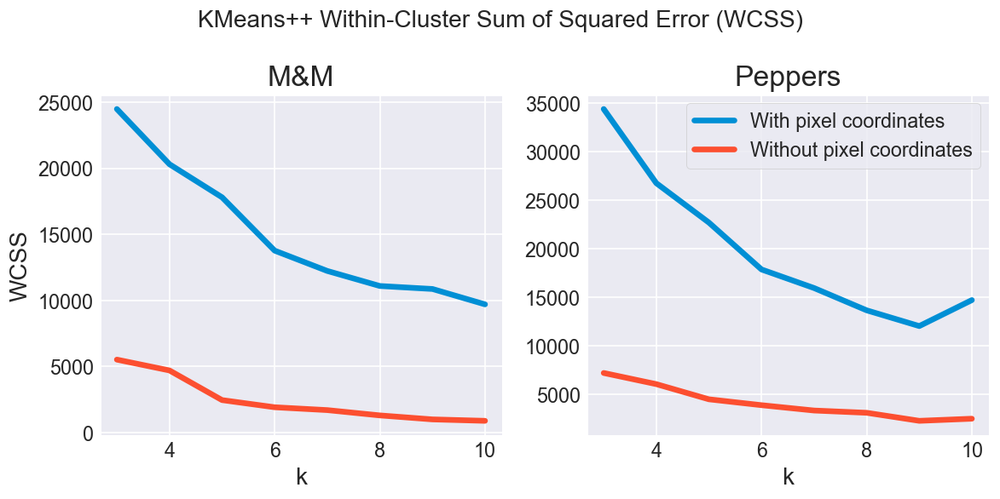

In [48]:
fig, axes = plt.subplots(1, 2, figsize=(10,5))
plt.suptitle('KMeans++ Within-Cluster Sum of Squared Error (WCSS)')

sns.lineplot(x=np.arange(start, end), y=score_with_xy_mandm, ax=axes[0])
sns.lineplot(x=np.arange(start, end), y=score_without_xy_mandm, ax=axes[0])
plt.legend(['With pixel coordinates', 'Without pixel coordinates'])
axes[0].set_xlabel('k')
axes[0].set_ylabel('WCSS')
axes[0].set_title('M&M')

sns.lineplot(x=np.arange(start, end), y=score_with_xy_peppers, ax=axes[1])
sns.lineplot(x=np.arange(start, end), y=score_without_xy_peppers, ax=axes[1])
plt.legend(['With pixel coordinates', 'Without pixel coordinates'])
axes[1].set_xlabel('k')
# axes[1].set_ylabel('Sum of Within-Cluster Sum of Squared Error')
axes[1].set_title('Peppers')

plt.tight_layout()

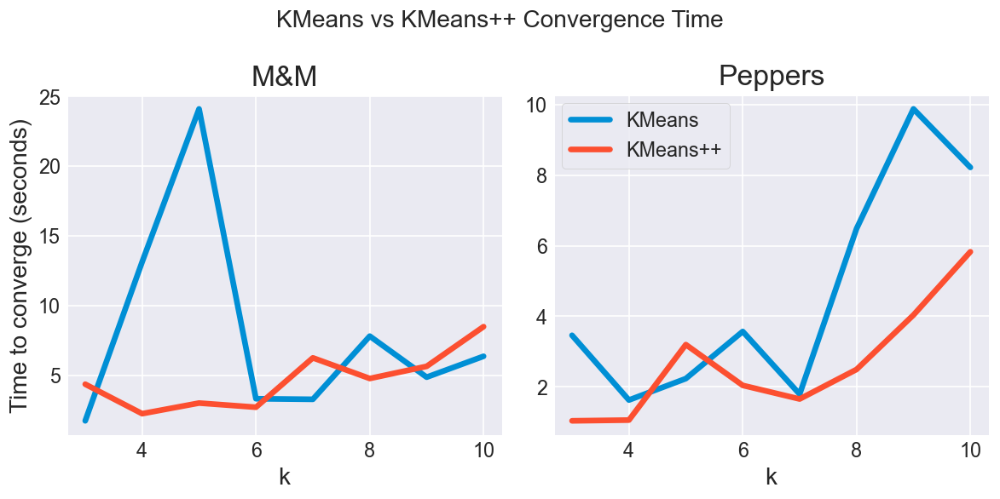

In [49]:
fig, axes = plt.subplots(1, 2, figsize=(10,5))
plt.suptitle('KMeans vs KMeans++ Convergence Time')

sns.lineplot(x=np.arange(start, end), y=conv_time_kmeans_mandm, ax=axes[0])
sns.lineplot(x=np.arange(start, end), y=conv_time_kmeanspp_mandm, ax=axes[0])
# plt.legend(['KMeans', 'KMeans++'])
axes[0].set_xlabel('k')
axes[0].set_ylabel('Time to converge (seconds)')
axes[0].set_title('M&M')

sns.lineplot(x=np.arange(start, end), y=conv_time_kmeans_peppers, ax=axes[1])
sns.lineplot(x=np.arange(start, end), y=conv_time_kmeanspp_peppers, ax=axes[1])
plt.legend(['KMeans', 'KMeans++'])
axes[1].set_xlabel('k')
# axes[1].set_ylabel('Time to converge (seconds)')
axes[1].set_title('Peppers')

plt.tight_layout()

# Task 3: Eigenface

## 3.1. Read in images

In [50]:
f_path = 'Task3/Yale-FaceA/trainingset'
A = []

for f_name in os.listdir(f_path):
    img = plt.imread(os.path.join(f_path, f_name))
    A += img.flatten(),

A = np.array(A)
A.shape

(135, 45045)

In [51]:
dim = plt.imread(os.path.join(f_path, f_name)).shape
dim

(231, 195)

### Explain why alignment is necessary for eigen-face

Alignment is necessary because face detection using eigenface is not invariant to position or scale.

Each pixel coordinate position i, j is essentially treated as a distinct random variable (that may or may not correlate with others).

If the images are not aligned, it will be difficult to find correlation or direction of maximum variance.

## 3.2. Perform PCA and show mean face

In [52]:
class PCA:
    def fit_transform(self, X: np.ndarray, n_components: int) -> Tuple[np.ndarray, np.ndarray]:
        """
        input:
            X: n by m where n is the number of data points and m is the number of features
        """
        self.X = X
    
        # create mean face by averaging the pixel intensity values across all our flattened face images
        self.mean = self.X.mean(0)
        self.X_centered = X - self.mean
        
        U, s, VT = LA.svd(X, full_matrices=False)
        self.svd_output = (U, s, VT)
        self.ev = self.explained_variance(s)
        
        S = np.diag(s)
        Xapprox = U[:,:n_components] @ S[:n_components,:n_components] @ VT[:n_components,:]
        return Xapprox + self.mean
    
    def explained_variance(self, s):
        ev = s ** 2 / np.sum(s ** 2)
        return ev

In [53]:
k = 15
model = PCA()
A_approx = model.fit_transform(A, n_components=k)

Text(0.5, 1.0, 'Mean face')

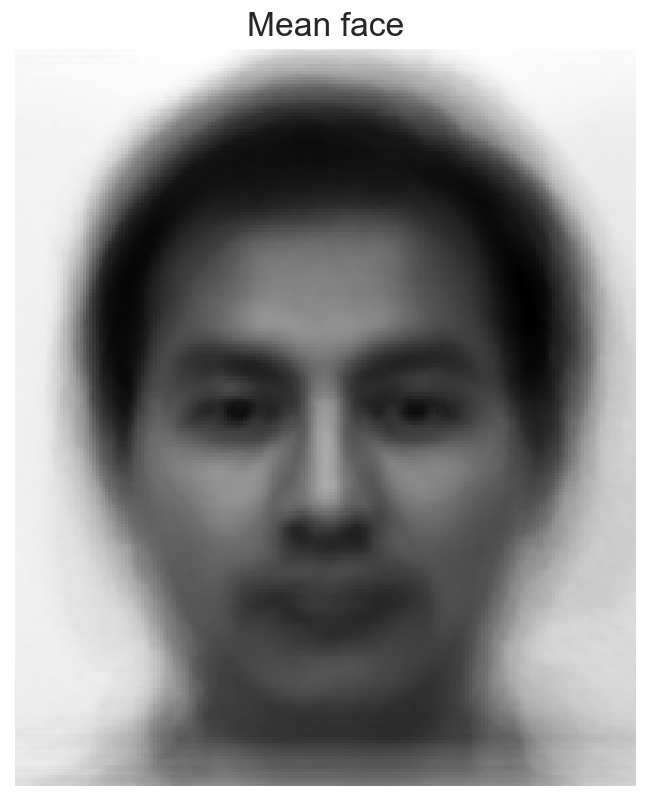

In [54]:
plt.figure(figsize=(6,8))
plt.imshow(model.mean.reshape(dim), cmap='gray')
# plt.grid(False)
plt.xticks([])
plt.yticks([])
plt.title('Mean face')

In [55]:
A.shape

(135, 45045)

### Given the high dimensionality, directly performing eigen value decomposition of the covariance matrix would be slow. Find a faster way to compute eigen values and vectors, explain the reason.

Assumption: We don't care about eigenvalues that are approximately 0.

If $A$ is a real matrix, then $AA^T$ and $A^TA$ are symmetric square matrices.

Let matrix $A \in \mathbb{R}^{n \times m}$, where $m \gt n$. Then, matrix $AA^T = L \in \mathbb{R}^{n \times n}$ and $A^TA = L \in \mathbb{R}^{m \times m}$.

1. Since the number of nonzero eigenvectors of $AA^T$ is not greater than the number of eigenvectors of $A^TA$, we can perform eigendecomposition of $AA^T = L \in \mathbb{R}^{n \times n}$ to get eigenvectors and eigenvalues of $A^TA = L \in \mathbb{R}^{m \times m}$. Since $AA^T = L \in \mathbb{R}^{n \times n}$ is smaller (135 x 135) than (45045, 45045), it is much faster.
    - If $v$ is an eigenvector with nonzero eigenvalue $\lambda$ of $A^TA$, then $Av$ is an eigenvector with the same eigenvalue of $AA^T$.
2. Perform SVD directly on $A$, taking advantage of existing algorithms that can obtain eigenvalues and eigenvectors of the covariance matrix of $A$ without having to compute $A^TA$.

## 3.3. Determine top k principal components and visualize top k eigenfaces

In [56]:
ev = model.ev
title = 'Explained Variance ratio (cumulative)'

Text(0.5, 1.0, 'Explained Variance ratio (cumulative)')

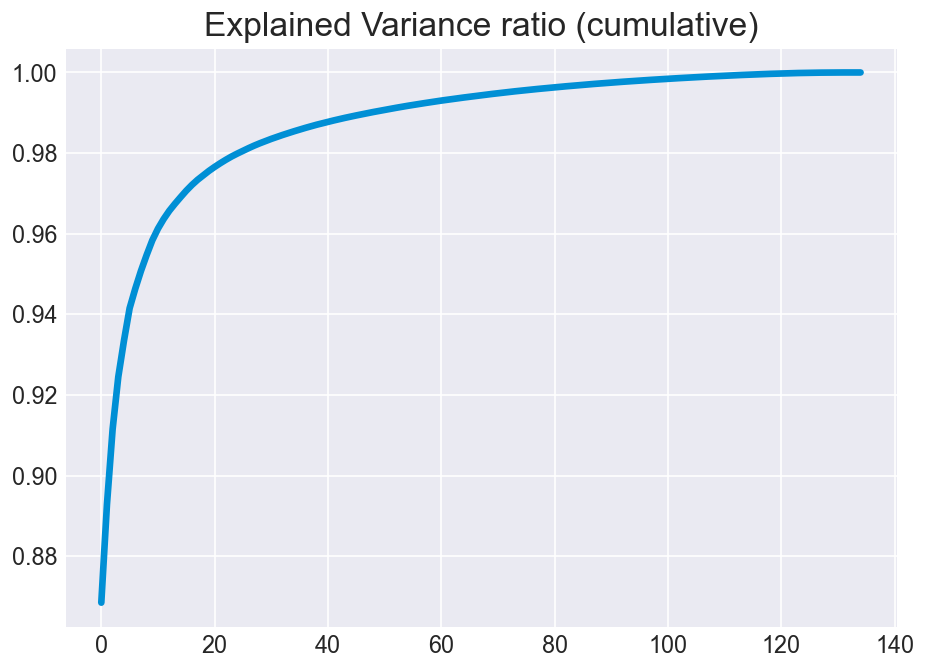

In [57]:
plt.figure(figsize=(8,6))
plt.plot(np.cumsum(ev))
plt.title(title)

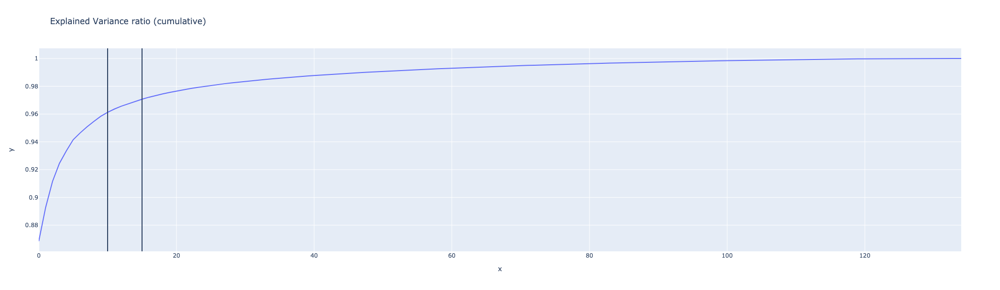

In [58]:
fig = px.line(x=np.arange(ev.shape[0], dtype=int), y=np.cumsum(ev), width=1000, height=600, title=title)
fig = fig.add_vline(x=15)
fig = fig.add_vline(x=10)
fig.show()

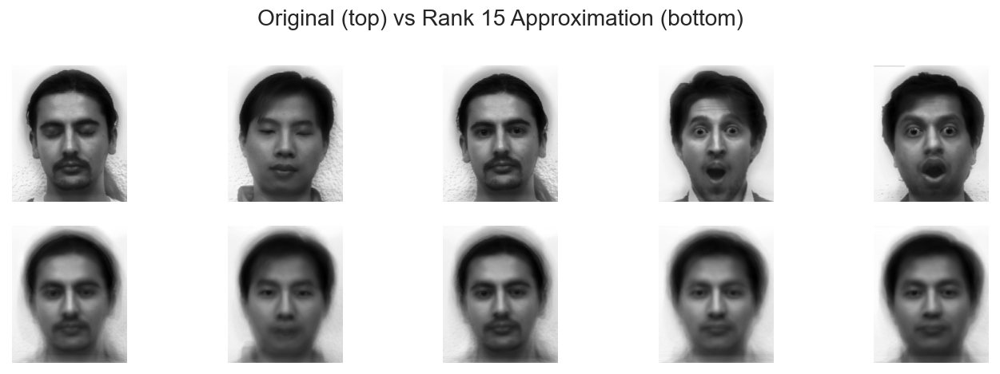

In [59]:
plt.figure(figsize=(12, 4))
c = 0
plt.suptitle(f'Original (top) vs Rank {k} Approximation (bottom)')

for i in range(0, A.shape[0], 5):
    if c+1+5 > 10:
        break
        
    plt.subplot(2, 5, c+1)
    plt.imshow(A[i].reshape(dim) + model.mean.reshape(dim), cmap='gray')
    # plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    
    plt.subplot(2, 5, c+1+5)
    plt.imshow(A_approx[i].reshape(dim) + model.mean.reshape(dim), cmap='gray')
    # plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    
    
    c += 1

plt.tight_layout()

In [60]:
U, s, VT = model.svd_output

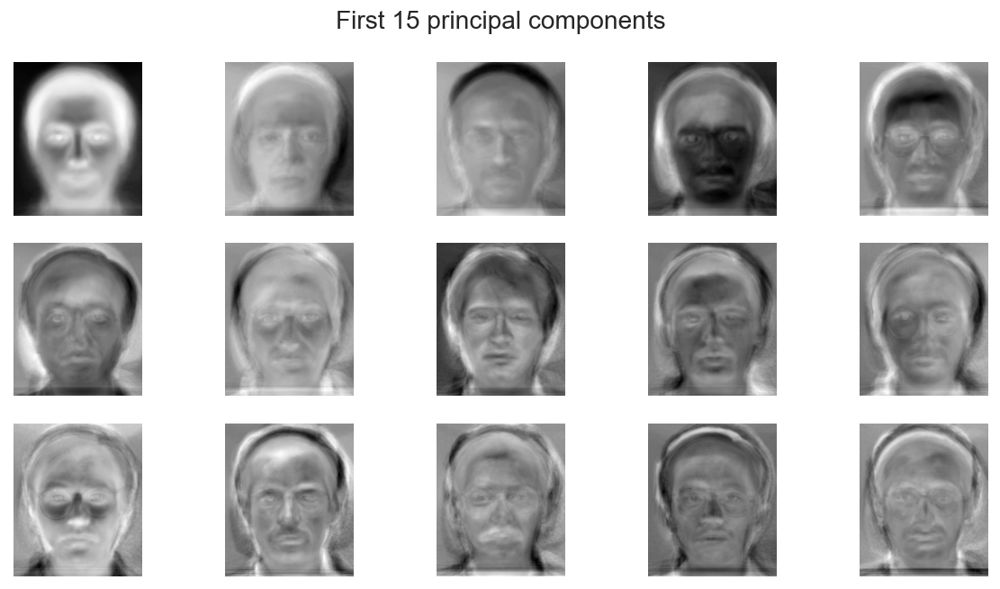

In [61]:
plt.figure(figsize=(10, 9))
plt.suptitle(f'First {k} principal components')

for i in range(k):
    plt.subplot(5, 5, i+1)
    plt.imshow(VT[i].reshape(dim), cmap='gray')
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])

plt.tight_layout()

## 3.4. Project test data to facespace spanned by first k eigenvectors and perform nearest neighbor search

In [62]:
f_path = 'Task3/Yale-FaceA/testset/'
test_images = []

for f_name in os.listdir(f_path):
    if not f_name.endswith('.png'):
        continue
        
    img = plt.imread(os.path.join(f_path, f_name))
    if len(img.shape) >= 3:
        img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        
    test_images += img.flatten(),

test_images = np.array(test_images)
test_images.shape

(10, 45045)

In [63]:
U, s, VT = model.svd_output

In [64]:
idx = np.random.randint(0, test_images.shape[0])
x = test_images[idx]
x.shape

(45045,)

In [65]:
x_projected = x @ VT[:k,:].T
x_projected.shape

(15,)

In [66]:
train_images_projected = A @ VT[:k,:].T
train_images_projected.shape

(135, 15)

In [67]:
dist = np.sqrt(np.sum((train_images_projected - x_projected) ** 2, axis=1))
dist.shape

(135,)

MSE range [0, 1]


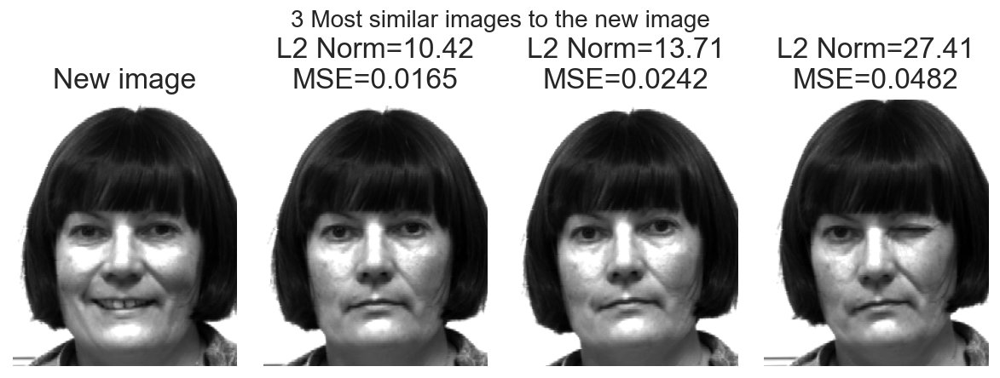

In [68]:
plt.figure(figsize=(10, 4))
plt.suptitle('3 Most similar images to the new image')
nearest_idx = np.argsort(dist)

plt.subplot(1, 4, 1)
plt.imshow(x.reshape(dim), cmap='gray')
plt.grid(False)
plt.xticks([])
plt.yticks([])
plt.title('New image')

for i in range(3):
    idx = nearest_idx[i]
    mse = np.mean((x - A[idx]) ** 2)
    plt.subplot(1, 4, i+2)
    plt.imshow(A[idx].reshape(dim), cmap='gray')
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    plt.title(f'L2 Norm={dist[idx]:.2f}\nMSE={mse:.4f}')

plt.tight_layout()

print('MSE range [0, 1]')

## 3.5. Repeat the above using a photo of self

In [69]:
f_path = 'Task3/selfies'
selfies = []

for f_name in os.listdir(f_path):
    if not f_name.endswith('.png'):
        continue
    img = plt.imread(os.path.join(f_path, f_name))
    selfies += img,

selfies = np.array(selfies)

In [70]:
height = 2000

top = 400
bottom = top + height

width = int(height / (dim[0] / dim[1]))
left = (img.shape[1] - width) // 2
right = left + width
x, y = dim
cropped_and_resized = []

for img in selfies:
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    cropped = img[top:bottom, left:right]
    resized = cv2.resize(cropped, (y, x))
    cropped_and_resized += resized,
    
selfies = cropped_and_resized

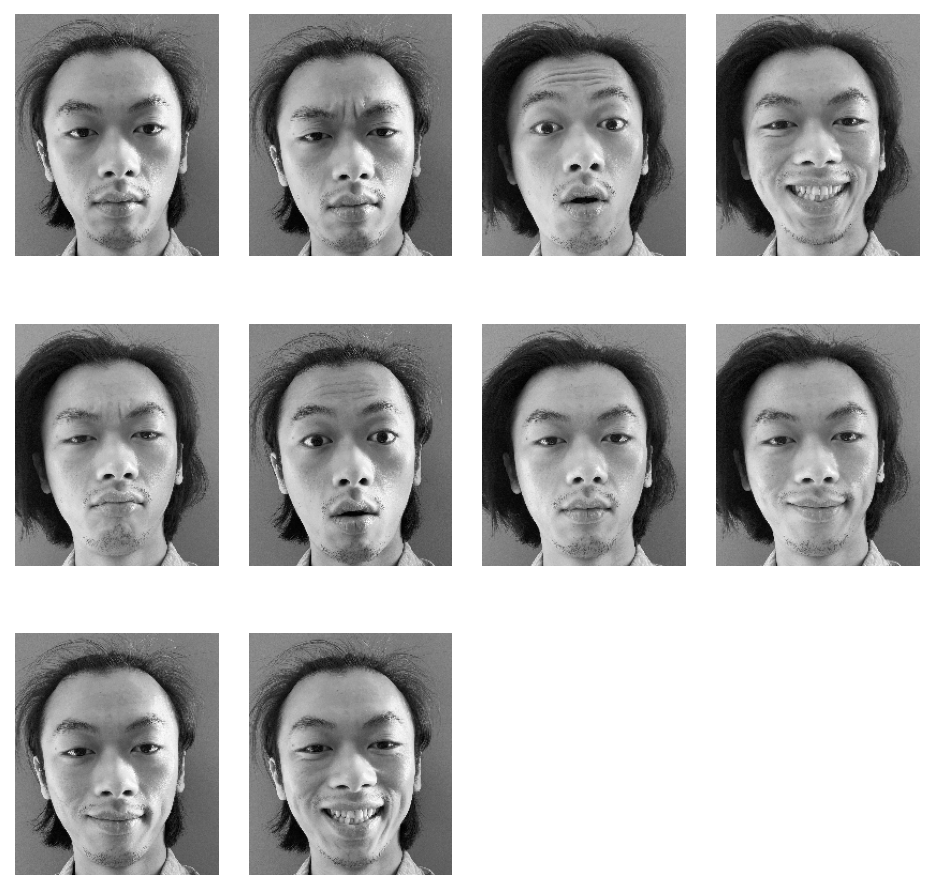

In [71]:
plt.figure(figsize=(8, 8))

for i, img in enumerate(selfies):
    plt.subplot(3, 4, i+1)
    plt.imshow(img, cmap='gray')
    plt.xticks([])
    plt.yticks([])
    # plt.grid(True)
    # plt.title()
    
plt.tight_layout()

In [72]:
selfies = np.array(selfies)
selfies = selfies.reshape(10, -1)
selfies.shape

(10, 45045)

In [73]:
idx = np.arange(selfies.shape[0], dtype=int)
np.random.shuffle(idx)
idx

array([7, 6, 9, 8, 1, 5, 4, 2, 3, 0])

In [74]:
selfies_test = selfies[idx[0]]
selfies_train = selfies[idx[1:]]

In [75]:
selfies_test_projected = selfies_test @ VT[:k,:].T
print(selfies_test_projected.shape)

selfies_train_projected = selfies_train @ VT[:k,:].T
print(selfies_train_projected.shape)

(15,)
(9, 15)


In [76]:
dist = np.sqrt(np.sum((train_images_projected - selfies_test_projected) ** 2, axis=1))
nearest_idx = np.argsort(dist)

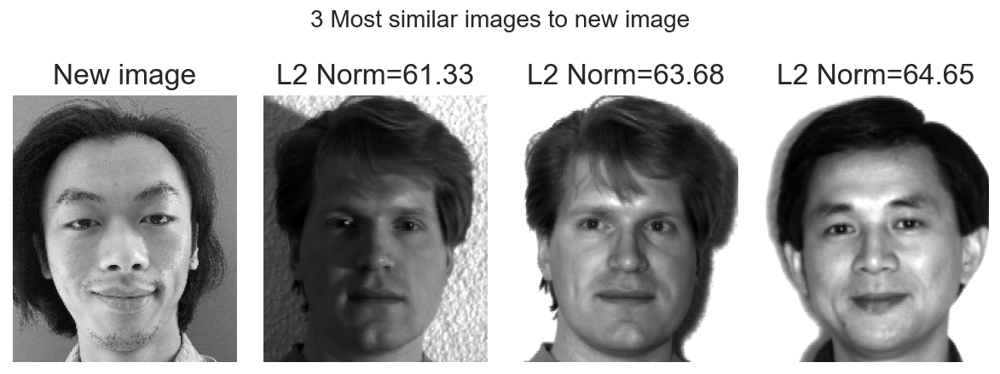

In [77]:
plt.figure(figsize=(10, 4))
plt.suptitle('3 Most similar images to new image')

plt.subplot(1, 4, 1)
plt.imshow(selfies_test.reshape(dim), cmap='gray')
plt.grid(False)
plt.xticks([])
plt.yticks([])
plt.title('New image')

for i in range(3):
    idx = nearest_idx[i]
    plt.subplot(1, 4, i+2)
    plt.imshow(A[idx].reshape(dim), cmap='gray')
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    plt.title(f'L2 Norm={dist[idx]:.2f}')

plt.tight_layout()

## 3.6. Repeat the above, with rest of selfies used as part of training set

In [78]:
train_images = A

combined_train_images_projected = np.vstack([train_images_projected, selfies_train_projected])
combined_train_images = np.vstack([train_images, selfies_train])

In [79]:
dist = np.sqrt(np.sum((combined_train_images_projected - selfies_test_projected) ** 2, axis=1))
nearest_idx = np.argsort(dist)

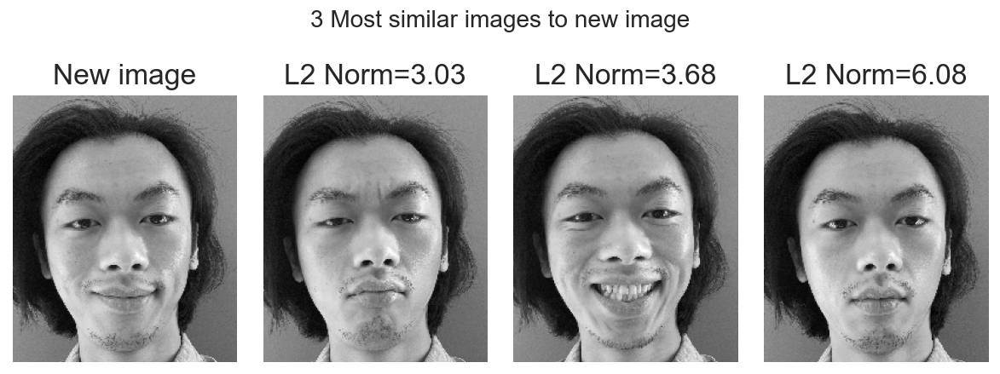

In [80]:
plt.figure(figsize=(10, 4))
plt.suptitle('3 Most similar images to new image')


plt.subplot(1, 4, 1)
plt.imshow(selfies_test.reshape(dim), cmap='gray')
plt.grid(False)
plt.xticks([])
plt.yticks([])
plt.title('New image')

for i in range(3):
    idx = nearest_idx[i]
    plt.subplot(1, 4, i+2)
    plt.imshow(combined_train_images[idx].reshape(dim), cmap='gray')
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    plt.title(f'L2 Norm={dist[idx]:.2f}')

plt.tight_layout()

# Sandbox

## Laplacian of Gaussian

In [3]:
from scipy import ndimage, signal, misc

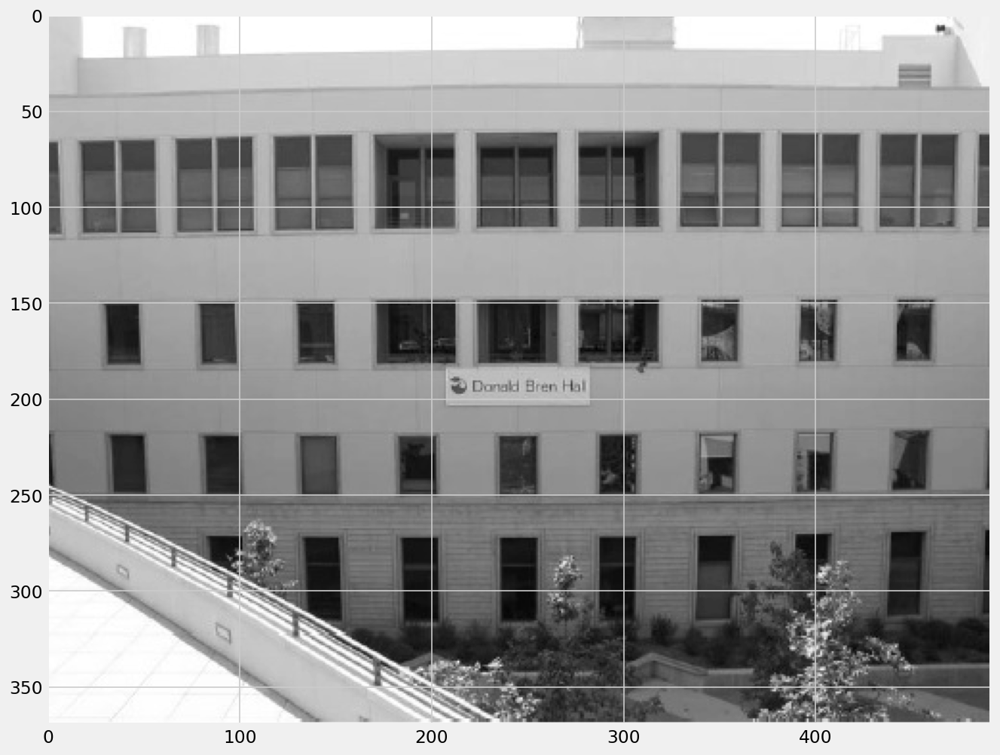

In [20]:
bw = plt.imread('Task1/Harris-1.jpg')
bw = cv2.cvtColor(bw, cv2.COLOR_RGB2GRAY)

plt.imshow(bw, cmap='gray')

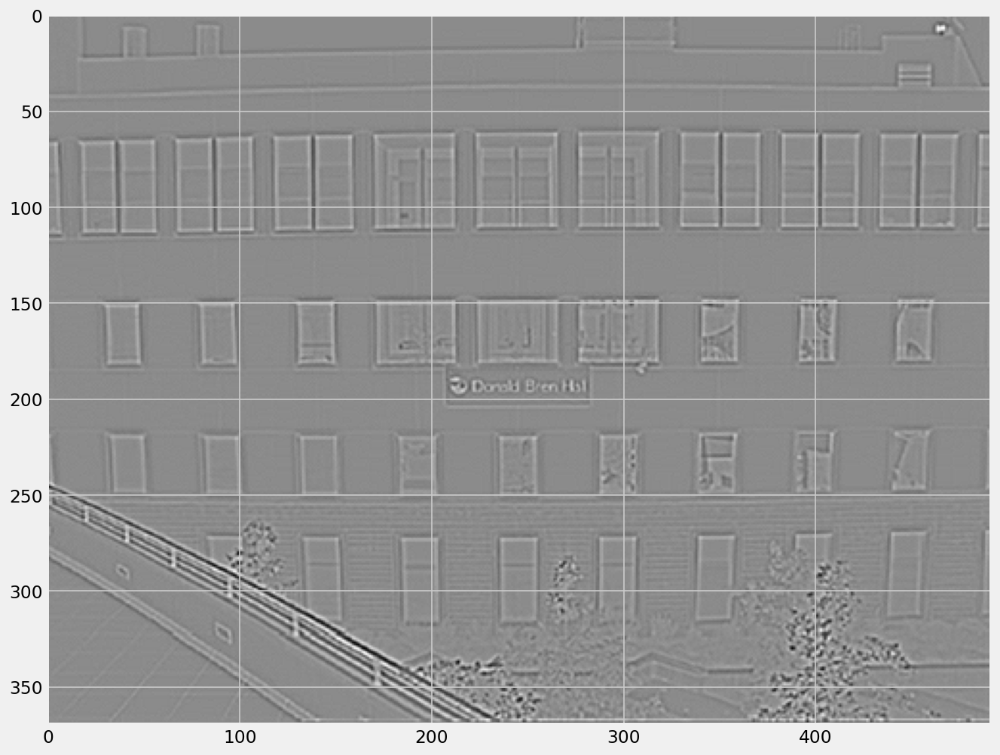

In [41]:
img = bw.copy()
sigma=3

# Apply Gaussian Blur
blur = cv2.GaussianBlur(img, (3,3), 0)

# Apply Laplacian operator in some higher datatype
laplacian = cv2.Laplacian(blur, cv2.CV_64F)

# clip negative
laplacian1 = laplacian / laplacian.max()
plt.imshow(laplacian1, cmap='gray')